# Test Notebook for developments of proper steering for nifty+maria

2024-12-09 20:39:44.034 INFO: Unable to initialize backend 'rocm': module 'jaxlib.xla_extension' has no attribute 'GpuAllocatorConfig'
2024-12-09 20:39:44.036 INFO: Unable to initialize backend 'tpu': INTERNAL: Failed to open libtpu.so: libtpu.so: cannot open shared object file: No such file or directory


Initialising...


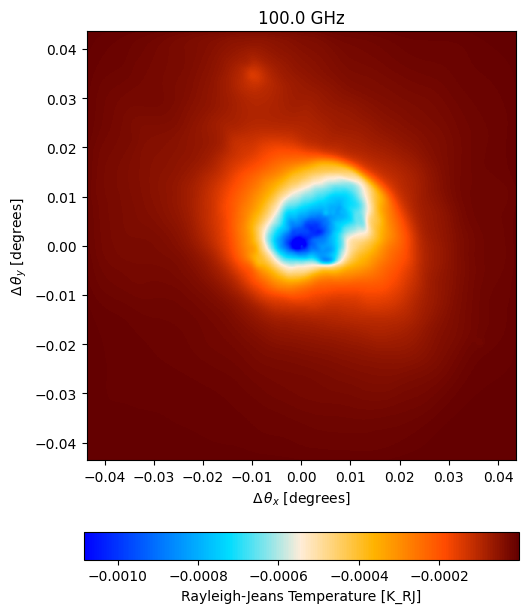

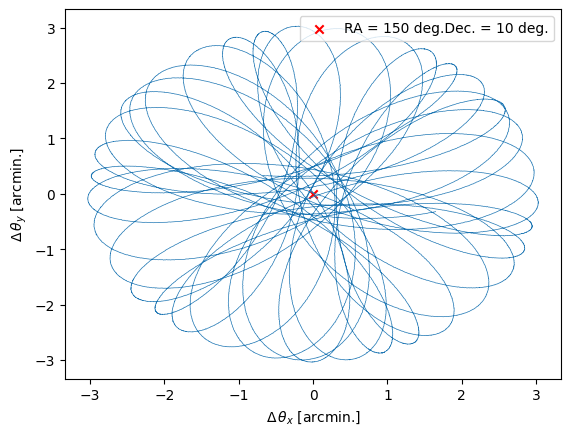

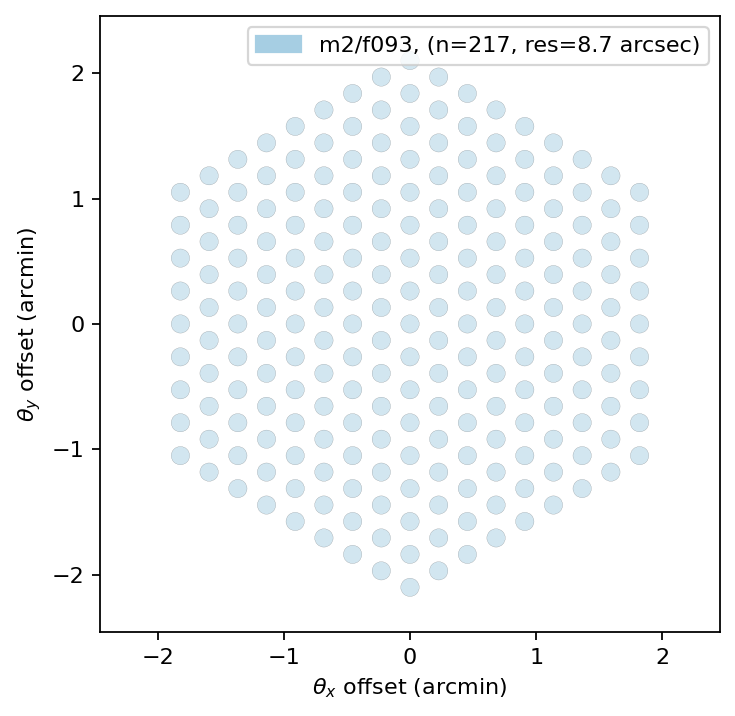

In [1]:
from nifty_maria.FitHandler import FitHandler

fit = FitHandler(config='mustang', fit_atmos=True, fit_map=True)
# fit = FitHandler(config='atlast_debug', fit_atmos=True, fit_map=True)
# fit = FitHandler(config='atlast', fit_atmos=True, fit_map=True)

2024-12-09 20:39:46.527 INFO: Initialized base in 1723 ms.
Building atmosphere: 100%|██████████| 6/6 [00:05<00:00,  1.03it/s]
2024-12-09 20:39:53.897 INFO: Initialized atmosphere in 7354 ms.
Generating noise: 100%|██████████| 1/1 [00:00<00:00,  1.99it/s]


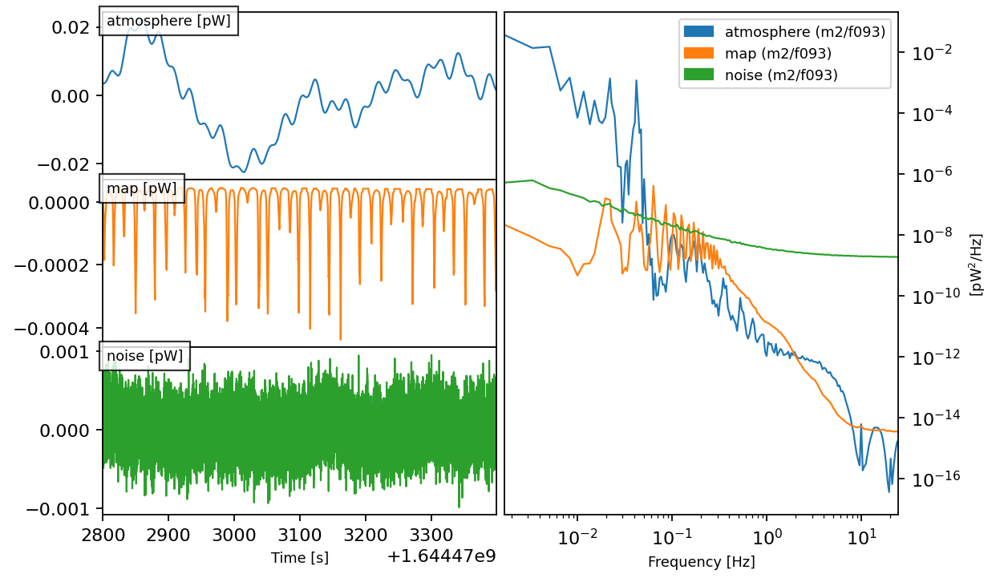

In [2]:
fit.simulate()

Running mapper (m2/f093): 100%|██████████| 1/1 [00:06<00:00,  6.09s/it]


mapdata_truth shape: (1, 1, 1000, 1000)
mapdata_truth mean: -8.726028151723567e-05


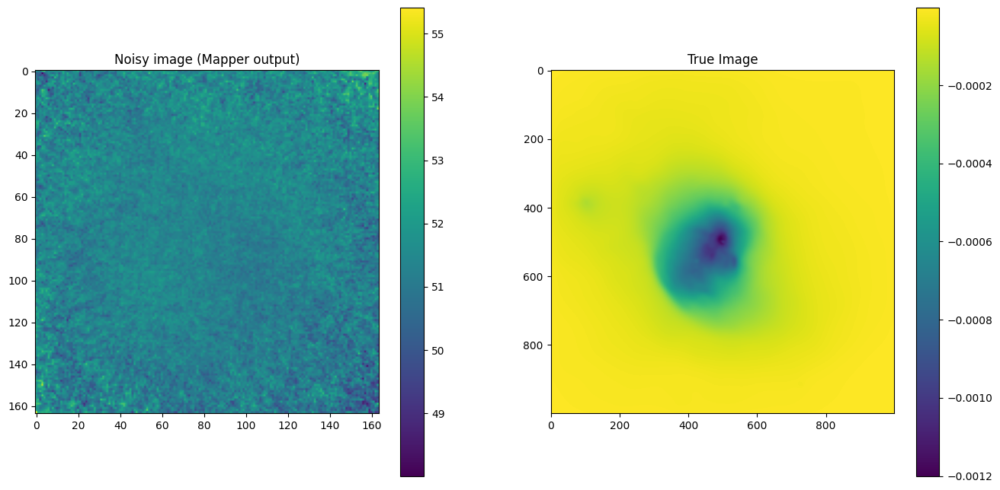

Running mapper (m2/f093): 100%|██████████| 1/1 [00:14<00:00, 14.05s/it]


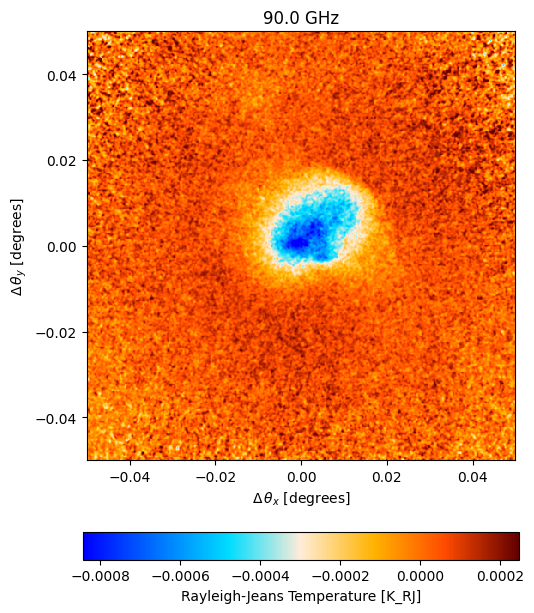

In [3]:
fit.reco_maria()

# JAX

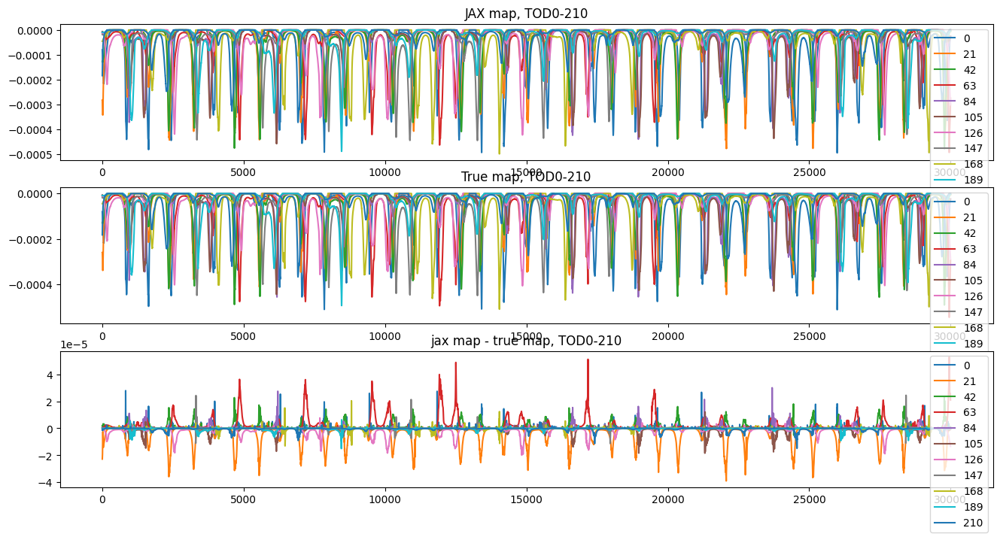

Noise stddev: 0.0002520310821251288


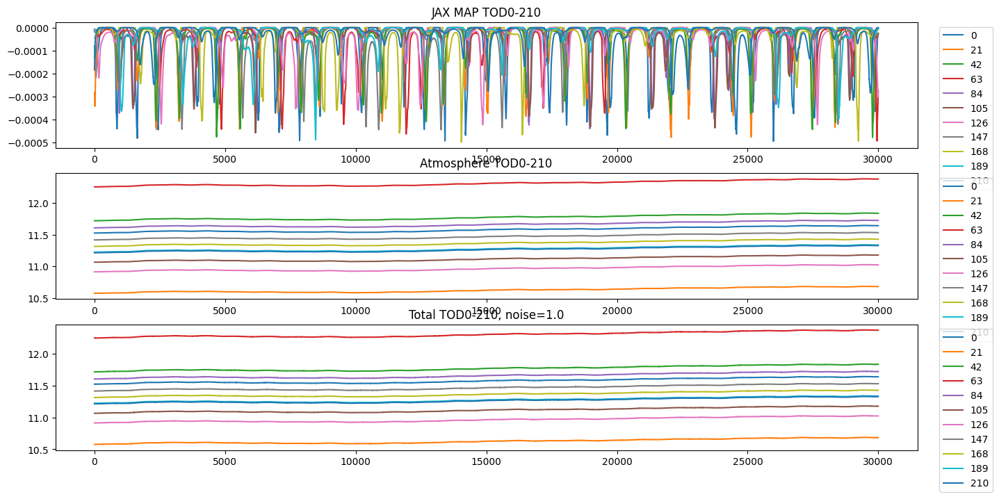

In [4]:
fit.sample_jax_tods(use_truth_slope=True)

In [5]:
fit.init_gps(n_split=0)

Initialised gp_tod: Model(
	<function CFM.finalize.<locals>.correlated_field at 0x14700bd56340>,
	domain={'combcf tod fluctuations': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'combcf tod loglogavgslope': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'combcf xi': ShapeWithDtype(shape=(1, 40000), dtype=<class 'jax.numpy.float64'>),
	 'combcf zeromode': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)},
	init=Initializer(
		{'combcf tod fluctuations': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'combcf tod loglogavgslope': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'combcf xi': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(1, 40000), dtype=<class 'jax.numpy.float64'>)),
		 'combcf zeromode': functools.partial(<function ra

assuming a diagonal covariance matrix;
setting `std_inv` to `cov_inv(ones_like(data))**0.5`


noise_cov_inv_tod <function FitHandler.__init__.<locals>.<lambda> at 0x147728163d80>
Initialising: Signal_TOD_general!!
INSIDE __init__(): Model(
	<function CFM.finalize.<locals>.correlated_field at 0x14700bd56340>,
	domain={'combcf tod fluctuations': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'combcf tod loglogavgslope': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'combcf xi': ShapeWithDtype(shape=(1, 40000), dtype=<class 'jax.numpy.float64'>),
	 'combcf zeromode': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)},
	init=Initializer(
		{'combcf tod fluctuations': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'combcf tod loglogavgslope': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'combcf xi': functools.partial(<function random_like at 0x147740c2e3e0>, primals=Sha

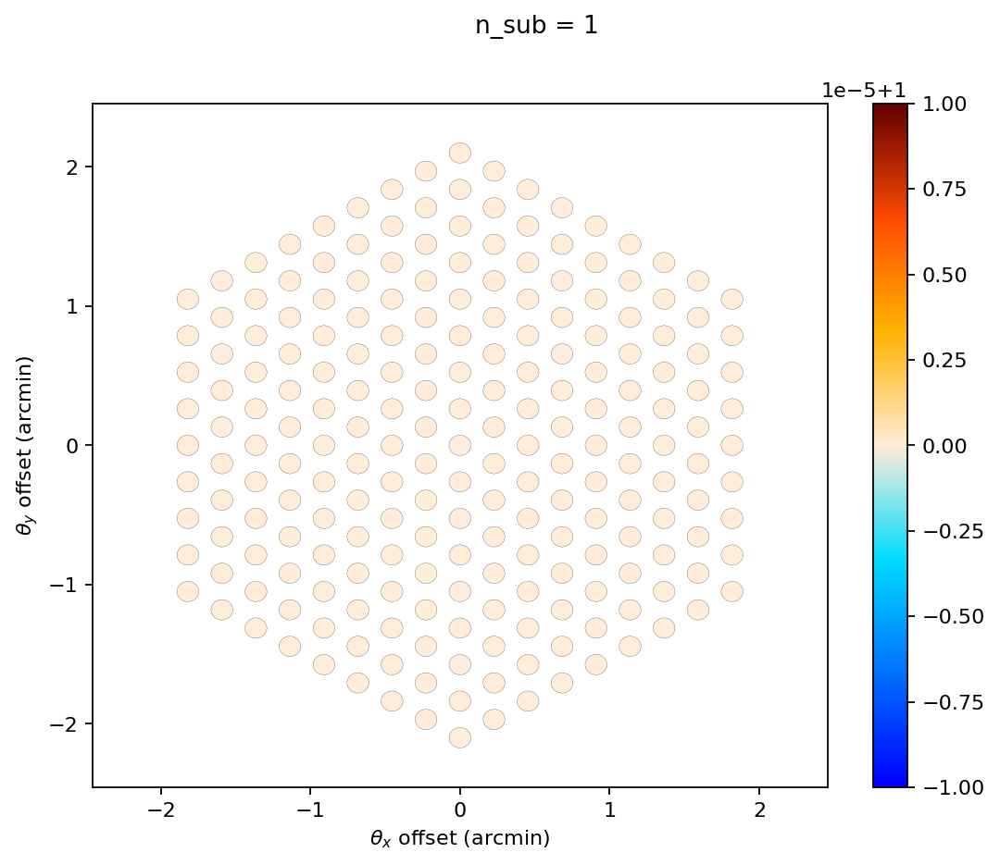

In [6]:
fit.plot_subdets()

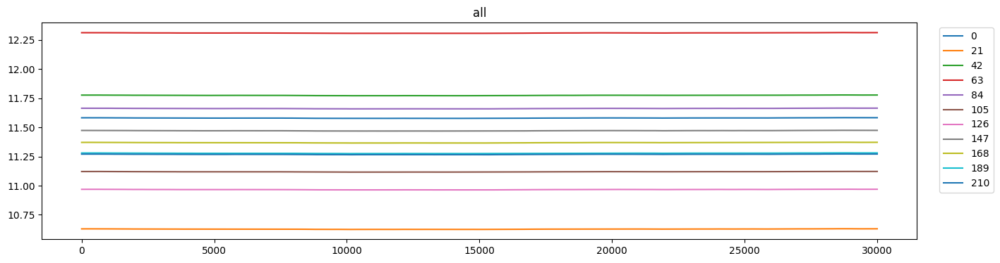

In [7]:
prior_s = fit.draw_prior_sample()

In [8]:
samples, state = fit.perform_fit(fit_type = 'map')

Running map fit!


OPTIMIZE_KL: Starting 0001
M: →:1.0 ↺:False #∇²:06 |↘|:2.740217e+02 ➽:1.060106e+02
M: Iteration 1 ⛰:+9.894870e+08 Δ⛰:6.431834e+10
M: →:1.0 ↺:False #∇²:12 |↘|:1.159128e+02 ➽:1.060106e+02
M: Iteration 2 ⛰:+2.720219e+08 Δ⛰:7.174651e+08
M: →:1.0 ↺:False #∇²:18 |↘|:6.269096e+01 ➽:1.060106e+02
M: Iteration 3 ⛰:+1.469104e+08 Δ⛰:1.251115e+08
OPTIMIZE_KL: Iteration 0001 ⛰:+1.4691e+08
OPTIMIZE_KL: #(KL minimization steps) 3
OPTIMIZE_KL: Likelihood residual(s):
'reduced χ²: 4.5e+01±     0.0, avg:    -0.42±     0.0, #dof:6510000'

OPTIMIZE_KL: Prior residual(s):
cfmapax1fluctuations    :: 'reduced χ²:    0.14±     0.0, avg:    -0.37±     0.0, #dof:      1'
cfmapax1loglogavgslope  :: 'reduced χ²:    0.44±     0.0, avg:    -0.66±     0.0, #dof:      1'
cfmapxi                 :: 'reduced χ²:     1.0±     0.0, avg: +0.00054±     0.0, #dof:1020100'
cfmapzeromode           :: 'reduced χ²:    0.17±     0.0, avg:    -0.41±     0.0, #dof:      1'
combcf tod fluctuations :: 'reduced χ²:  0.0042±     0.0, a

In [9]:
fit.printfitresults(samples)

Fit Results (res, init, std) for n_sub = 1

TODs:
	fluctuations: 0.0014902217413565828, 0.0015, 0.0001
	loglogvarslope: -2.0568922675790207, -2.45, 0.1
	zeromode std (LogNormal): 1.9337971022181143e-06, 1e-05, 9.9e-06
map:
	fluctuations: 5.5619116947018025e-05, 5.6e-05, 1e-06
	loglogvarslope: -2.566078468399733, -2.5, 0.1
	zeromode std (LogNormal): 4.1347577426423836e-10, 1e-08, 1e-07


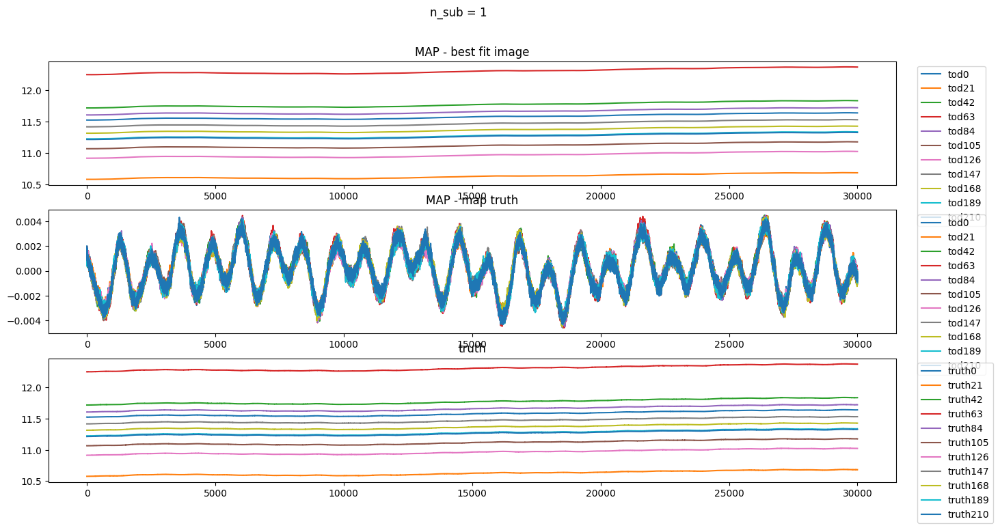

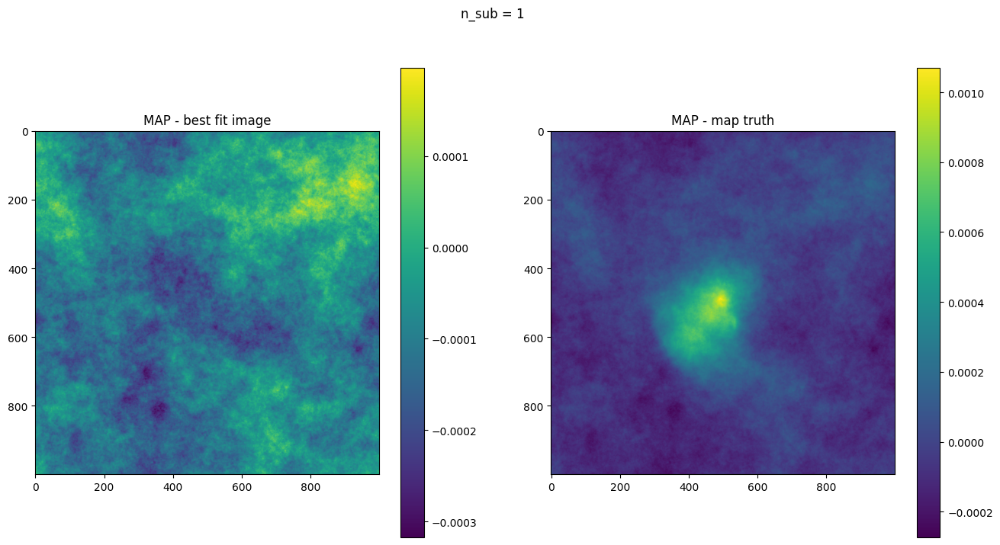

In [10]:
fit.plotfitresults(samples)

# Full fit

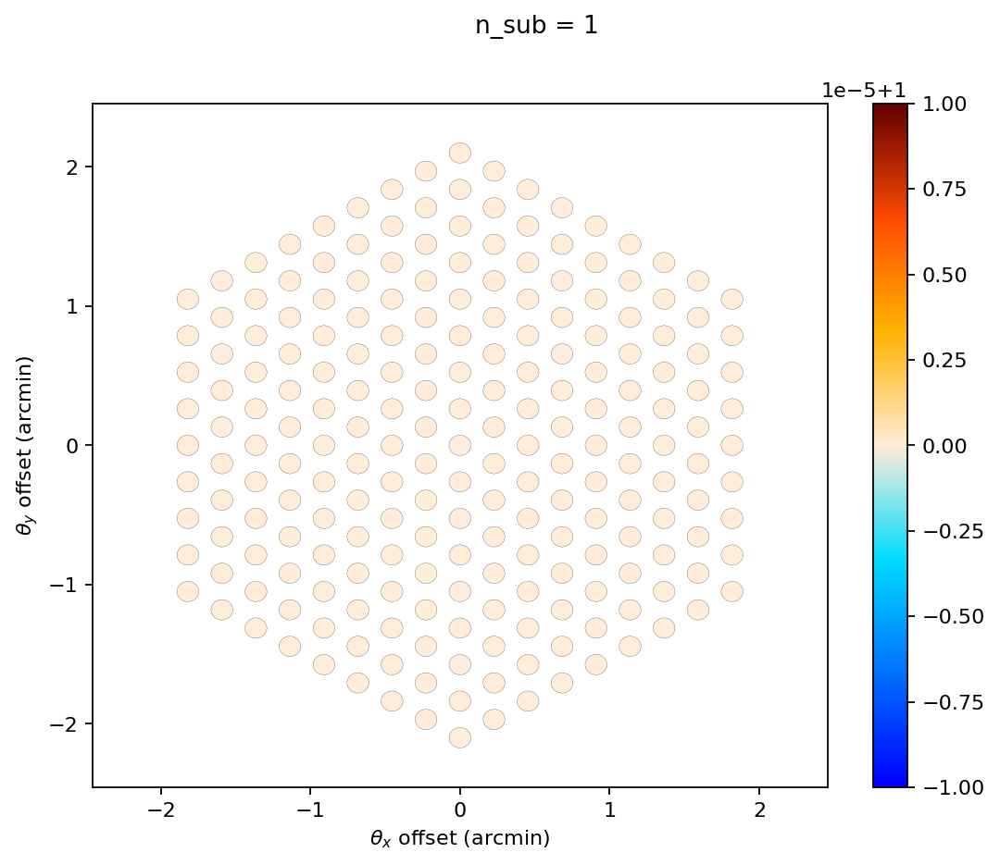

In [11]:
fit.plot_subdets()

OPTIMIZE_KL: Starting 0001


Running full fit!


SL: Iteration 0 ⛰:+2.1827e+08 Δ⛰:inf ➽:1.0601e+01
SL: Iteration 1 ⛰:+2.6138e+07 Δ⛰:1.9213e+08 ➽:1.0601e+01
SL: Iteration 2 ⛰:+1.5941e+07 Δ⛰:1.0198e+07 ➽:1.0601e+01
SL: Iteration 3 ⛰:+7.1008e+06 Δ⛰:8.8397e+06 ➽:1.0601e+01
SL: Iteration 4 ⛰:+4.1979e+06 Δ⛰:2.9029e+06 ➽:1.0601e+01
SL: Iteration 5 ⛰:+3.1778e+06 Δ⛰:1.0201e+06 ➽:1.0601e+01
SL: Iteration 6 ⛰:+1.4742e+06 Δ⛰:1.7036e+06 ➽:1.0601e+01
SL: Iteration 7 ⛰:+8.6889e+05 Δ⛰:6.0530e+05 ➽:1.0601e+01
SL: Iteration 8 ⛰:+5.8486e+05 Δ⛰:2.8404e+05 ➽:1.0601e+01
SL: Iteration 9 ⛰:+3.8053e+05 Δ⛰:2.0433e+05 ➽:1.0601e+01
SL: Iteration 10 ⛰:+1.8417e+05 Δ⛰:1.9636e+05 ➽:1.0601e+01
SL: Iteration 11 ⛰:+1.2555e+05 Δ⛰:5.8621e+04 ➽:1.0601e+01
SL: Iteration 12 ⛰:+4.9746e+04 Δ⛰:7.5802e+04 ➽:1.0601e+01
SL: Iteration 13 ⛰:-3.9934e+04 Δ⛰:8.9680e+04 ➽:1.0601e+01
SL: Iteration 14 ⛰:-4.6321e+04 Δ⛰:6.3864e+03 ➽:1.0601e+01
SL: Iteration 15 ⛰:-8.8717e+04 Δ⛰:4.2396e+04 ➽:1.0601e+01
SL: Iteration 16 ⛰:-1.8524e+05 Δ⛰:9.6524e+04 ➽:1.0601e+01
SL: Iteration 17 ⛰:-2.4991e+05 

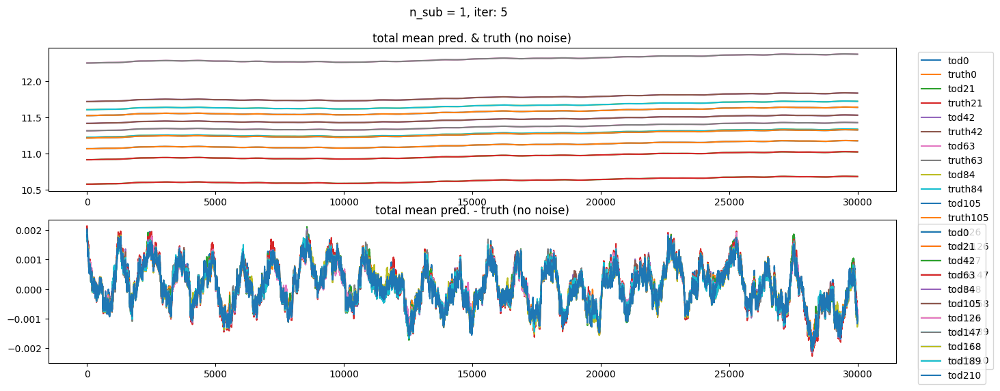

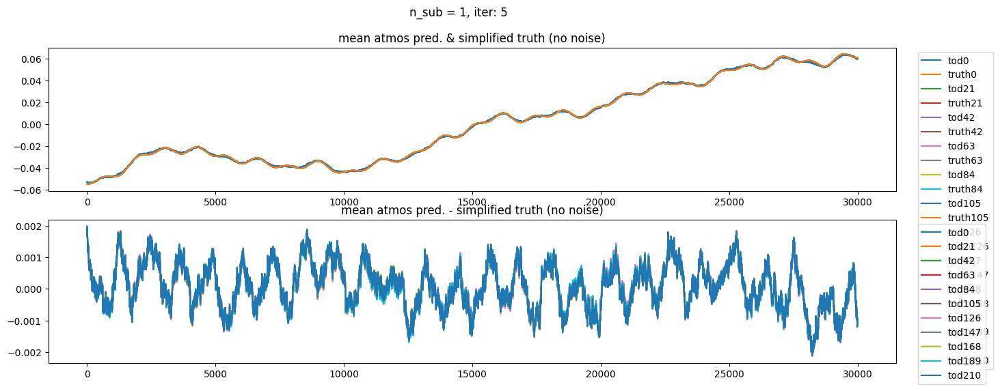

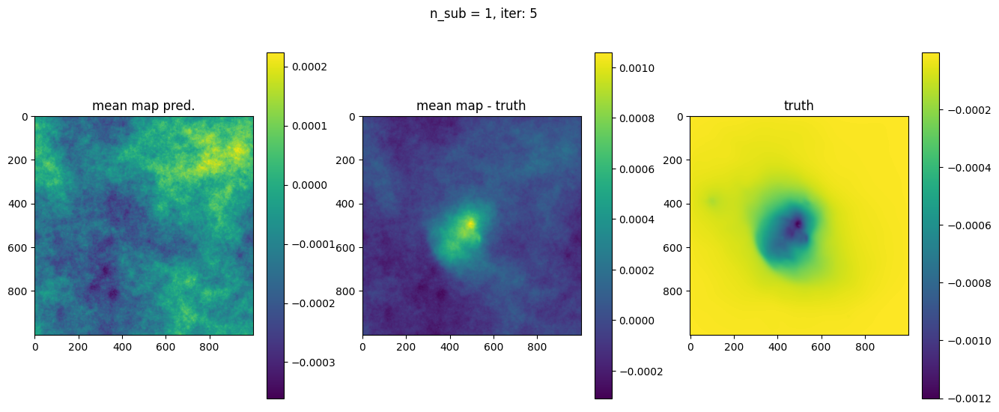

OPTIMIZE_KL: Starting 0006
SL: Iteration 0 ⛰:+1.3160e+09 Δ⛰:inf ➽:1.0601e+01
SL: Iteration 1 ⛰:+3.9609e+07 Δ⛰:1.2764e+09 ➽:1.0601e+01
SL: Iteration 2 ⛰:+2.8384e+07 Δ⛰:1.1225e+07 ➽:1.0601e+01
SL: Iteration 3 ⛰:+1.6717e+07 Δ⛰:1.1667e+07 ➽:1.0601e+01
SL: Iteration 4 ⛰:+1.0343e+07 Δ⛰:6.3745e+06 ➽:1.0601e+01
SL: Iteration 5 ⛰:+8.4107e+06 Δ⛰:1.9322e+06 ➽:1.0601e+01
SL: Iteration 6 ⛰:+7.2383e+06 Δ⛰:1.1723e+06 ➽:1.0601e+01
SL: Iteration 7 ⛰:+5.5398e+06 Δ⛰:1.6985e+06 ➽:1.0601e+01
SL: Iteration 8 ⛰:+4.8053e+06 Δ⛰:7.3455e+05 ➽:1.0601e+01
SL: Iteration 9 ⛰:+4.7491e+06 Δ⛰:5.6125e+04 ➽:1.0601e+01
SL: Iteration 10 ⛰:+4.3797e+06 Δ⛰:3.6948e+05 ➽:1.0601e+01
SL: Iteration 11 ⛰:+3.7574e+06 Δ⛰:6.2225e+05 ➽:1.0601e+01
SL: Iteration 12 ⛰:+3.2387e+06 Δ⛰:5.1868e+05 ➽:1.0601e+01
SL: Iteration 13 ⛰:+2.7719e+06 Δ⛰:4.6680e+05 ➽:1.0601e+01
SL: Iteration 14 ⛰:+2.3997e+06 Δ⛰:3.7222e+05 ➽:1.0601e+01
SL: Iteration 15 ⛰:+2.0246e+06 Δ⛰:3.7514e+05 ➽:1.0601e+01
SL: Iteration 16 ⛰:+2.0018e+06 Δ⛰:2.2765e+04 ➽:1.0601e+01
SL: 

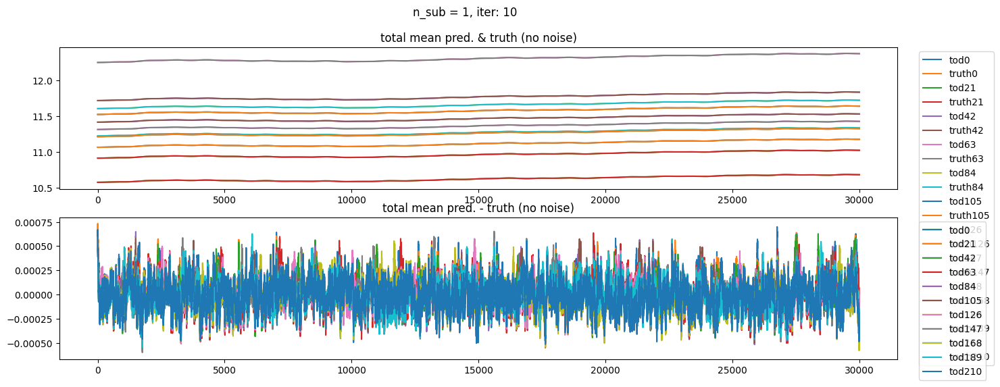

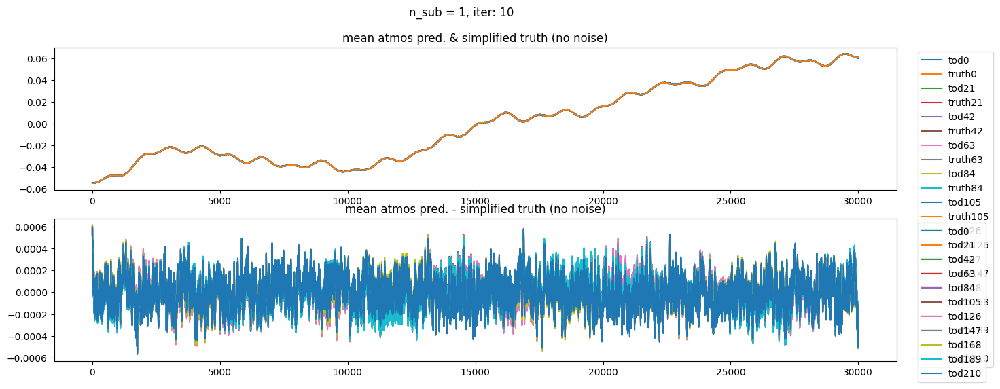

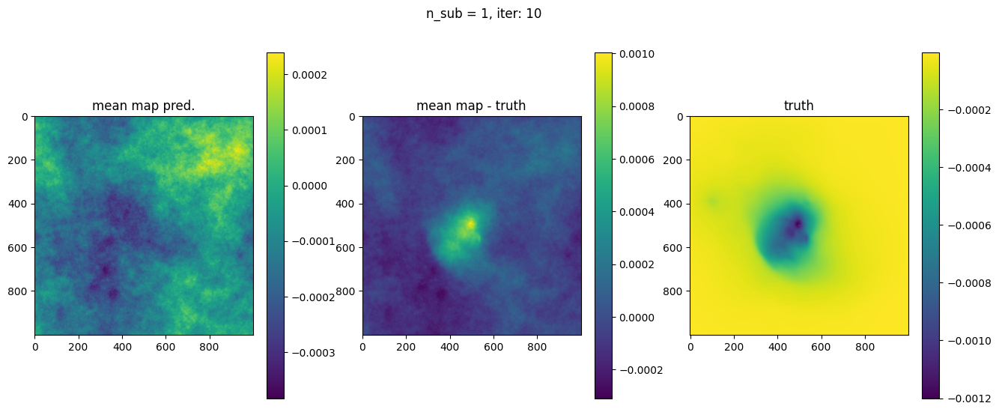

OPTIMIZE_KL: Starting 0011
SL: Iteration 0 ⛰:+1.3197e+08 Δ⛰:inf ➽:1.0601e+01
SL: Iteration 1 ⛰:+9.9218e+07 Δ⛰:3.2749e+07 ➽:1.0601e+01
SL: Iteration 2 ⛰:+2.4004e+07 Δ⛰:7.5213e+07 ➽:1.0601e+01
SL: Iteration 3 ⛰:+1.6228e+07 Δ⛰:7.7767e+06 ➽:1.0601e+01
SL: Iteration 4 ⛰:+1.0238e+07 Δ⛰:5.9898e+06 ➽:1.0601e+01
SL: Iteration 5 ⛰:+7.1541e+06 Δ⛰:3.0837e+06 ➽:1.0601e+01
SL: Iteration 6 ⛰:+5.8750e+06 Δ⛰:1.2791e+06 ➽:1.0601e+01
SL: Iteration 7 ⛰:+4.9163e+06 Δ⛰:9.5864e+05 ➽:1.0601e+01
SL: Iteration 8 ⛰:+4.0830e+06 Δ⛰:8.3333e+05 ➽:1.0601e+01
SL: Iteration 9 ⛰:+3.9857e+06 Δ⛰:9.7307e+04 ➽:1.0601e+01
SL: Iteration 10 ⛰:+3.4183e+06 Δ⛰:5.6733e+05 ➽:1.0601e+01
SL: Iteration 11 ⛰:+2.9546e+06 Δ⛰:4.6373e+05 ➽:1.0601e+01
SL: Iteration 12 ⛰:+2.4854e+06 Δ⛰:4.6920e+05 ➽:1.0601e+01
SL: Iteration 13 ⛰:+2.1341e+06 Δ⛰:3.5136e+05 ➽:1.0601e+01
SL: Iteration 14 ⛰:+1.8996e+06 Δ⛰:2.3450e+05 ➽:1.0601e+01
SL: Iteration 15 ⛰:+1.6116e+06 Δ⛰:2.8798e+05 ➽:1.0601e+01
SL: Iteration 16 ⛰:+1.6078e+06 Δ⛰:3.7538e+03 ➽:1.0601e+01
SL: 

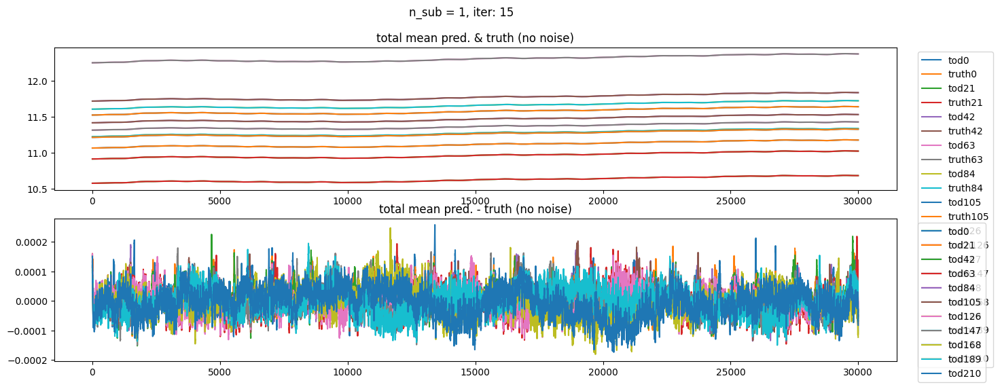

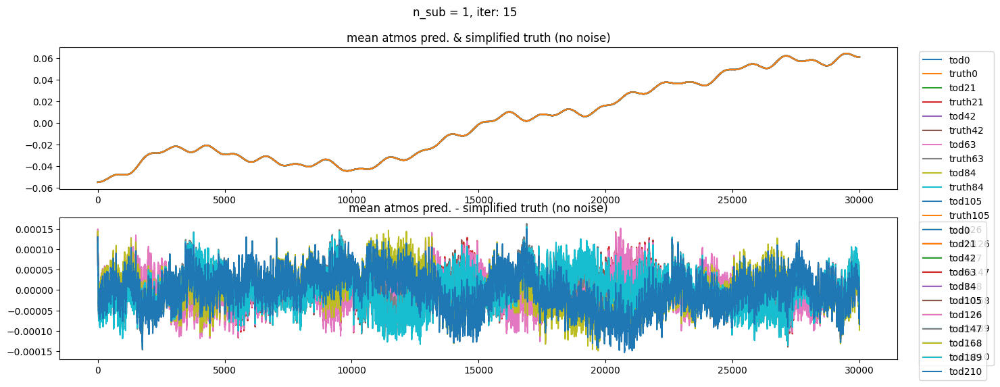

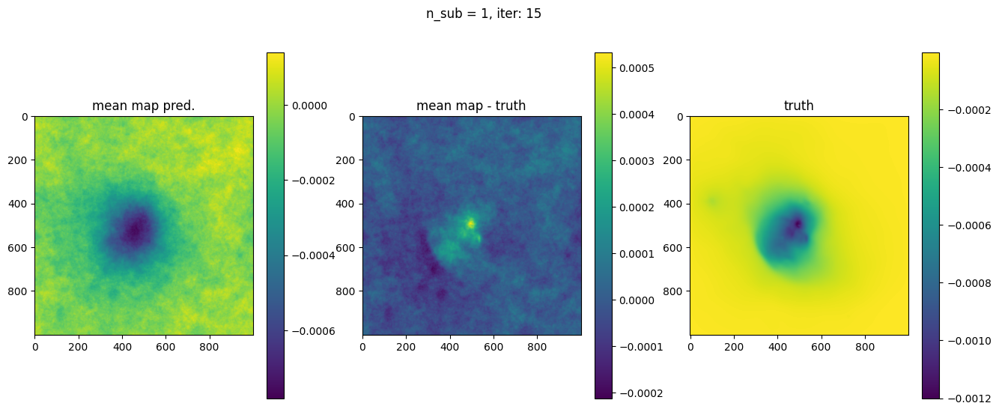

OPTIMIZE_KL: Starting 0016
SL: Iteration 0 ⛰:+5.9243e+07 Δ⛰:inf ➽:1.0601e+01
SL: Iteration 1 ⛰:+1.9868e+07 Δ⛰:3.9375e+07 ➽:1.0601e+01
SL: Iteration 2 ⛰:+7.8819e+06 Δ⛰:1.1986e+07 ➽:1.0601e+01
SL: Iteration 3 ⛰:+4.9875e+06 Δ⛰:2.8945e+06 ➽:1.0601e+01
SL: Iteration 4 ⛰:+3.1221e+06 Δ⛰:1.8654e+06 ➽:1.0601e+01
SL: Iteration 5 ⛰:+2.0002e+06 Δ⛰:1.1218e+06 ➽:1.0601e+01
SL: Iteration 6 ⛰:+1.5474e+06 Δ⛰:4.5281e+05 ➽:1.0601e+01
SL: Iteration 7 ⛰:+1.0143e+06 Δ⛰:5.3315e+05 ➽:1.0601e+01
SL: Iteration 8 ⛰:+7.7531e+05 Δ⛰:2.3895e+05 ➽:1.0601e+01
SL: Iteration 9 ⛰:+7.6184e+05 Δ⛰:1.3472e+04 ➽:1.0601e+01
SL: Iteration 10 ⛰:+5.4630e+05 Δ⛰:2.1555e+05 ➽:1.0601e+01
SL: Iteration 11 ⛰:+4.2754e+05 Δ⛰:1.1876e+05 ➽:1.0601e+01
SL: Iteration 12 ⛰:+3.1094e+05 Δ⛰:1.1659e+05 ➽:1.0601e+01
SL: Iteration 13 ⛰:+1.2348e+05 Δ⛰:1.8746e+05 ➽:1.0601e+01
SL: Iteration 14 ⛰:+1.0469e+05 Δ⛰:1.8794e+04 ➽:1.0601e+01
SL: Iteration 15 ⛰:+2.2185e+04 Δ⛰:8.2503e+04 ➽:1.0601e+01
SL: Iteration 16 ⛰:+2.1762e+04 Δ⛰:4.2309e+02 ➽:1.0601e+01
SL: 

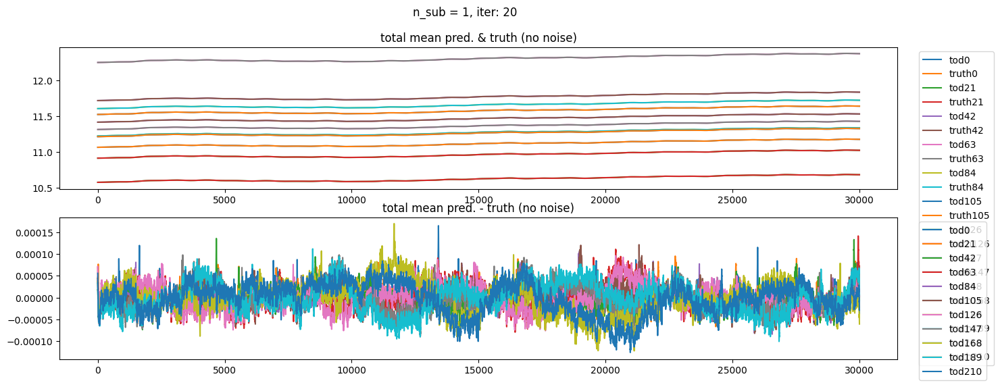

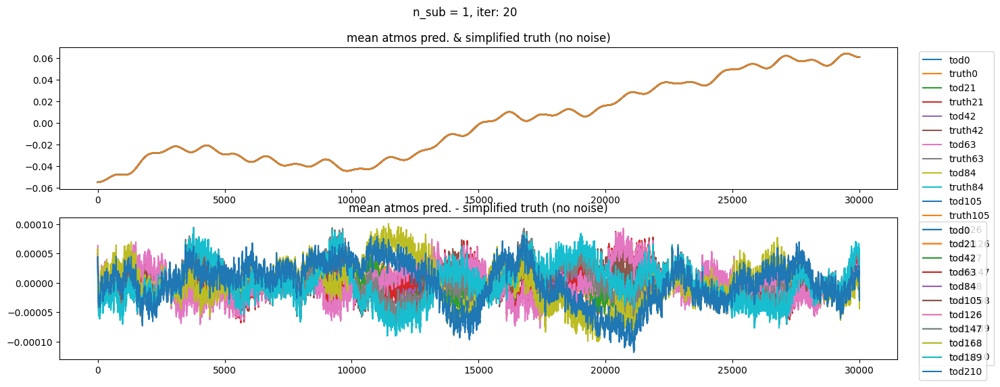

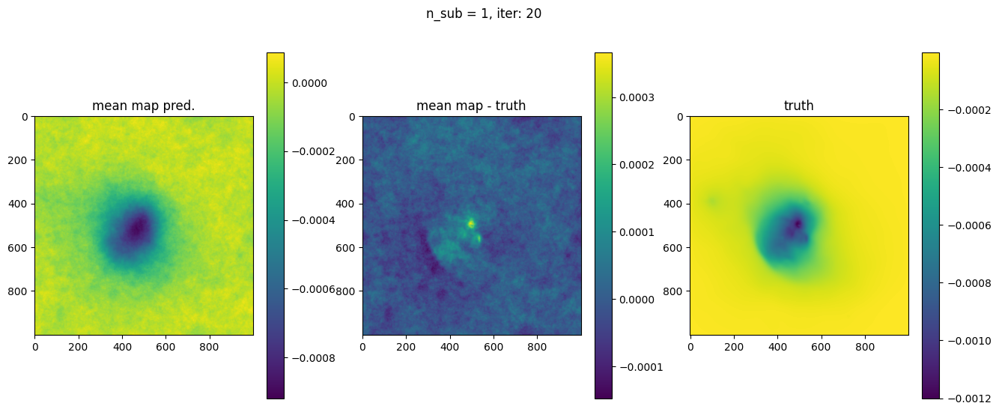

OPTIMIZE_KL: Starting 0021
SL: Iteration 0 ⛰:+1.8385e+08 Δ⛰:inf ➽:1.0601e+01
SL: Iteration 1 ⛰:+2.3886e+07 Δ⛰:1.5996e+08 ➽:1.0601e+01
SL: Iteration 2 ⛰:+7.8538e+06 Δ⛰:1.6032e+07 ➽:1.0601e+01
SL: Iteration 3 ⛰:+3.7713e+06 Δ⛰:4.0825e+06 ➽:1.0601e+01
SL: Iteration 4 ⛰:+3.0491e+06 Δ⛰:7.2224e+05 ➽:1.0601e+01
SL: Iteration 5 ⛰:+1.0057e+06 Δ⛰:2.0434e+06 ➽:1.0601e+01
SL: Iteration 6 ⛰:+5.6691e+05 Δ⛰:4.3883e+05 ➽:1.0601e+01
SL: Iteration 7 ⛰:+3.0773e+05 Δ⛰:2.5918e+05 ➽:1.0601e+01
SL: Iteration 8 ⛰:+1.0071e+05 Δ⛰:2.0702e+05 ➽:1.0601e+01
SL: Iteration 9 ⛰:+7.2596e+04 Δ⛰:2.8116e+04 ➽:1.0601e+01
SL: Iteration 10 ⛰:-2.0461e+04 Δ⛰:9.3057e+04 ➽:1.0601e+01
SL: Iteration 11 ⛰:-1.3948e+05 Δ⛰:1.1902e+05 ➽:1.0601e+01
SL: Iteration 12 ⛰:-2.1379e+05 Δ⛰:7.4311e+04 ➽:1.0601e+01
SL: Iteration 13 ⛰:-2.5863e+05 Δ⛰:4.4841e+04 ➽:1.0601e+01
SL: Iteration 14 ⛰:-2.5949e+05 Δ⛰:8.6034e+02 ➽:1.0601e+01
SL: Iteration 15 ⛰:-2.6030e+05 Δ⛰:8.0713e+02 ➽:1.0601e+01
SL: Iteration 16 ⛰:-3.0255e+05 Δ⛰:4.2244e+04 ➽:1.0601e+01
SL: 

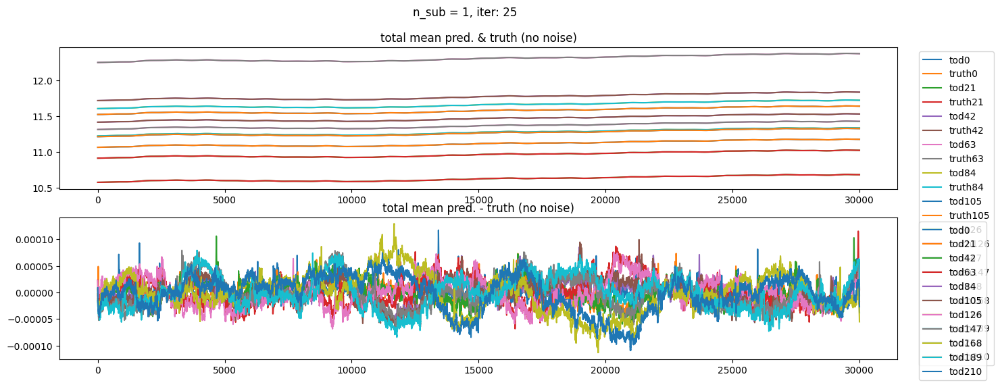

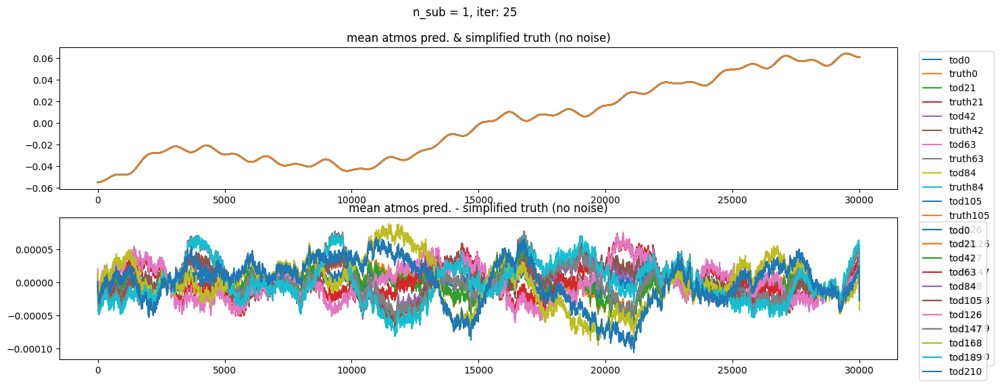

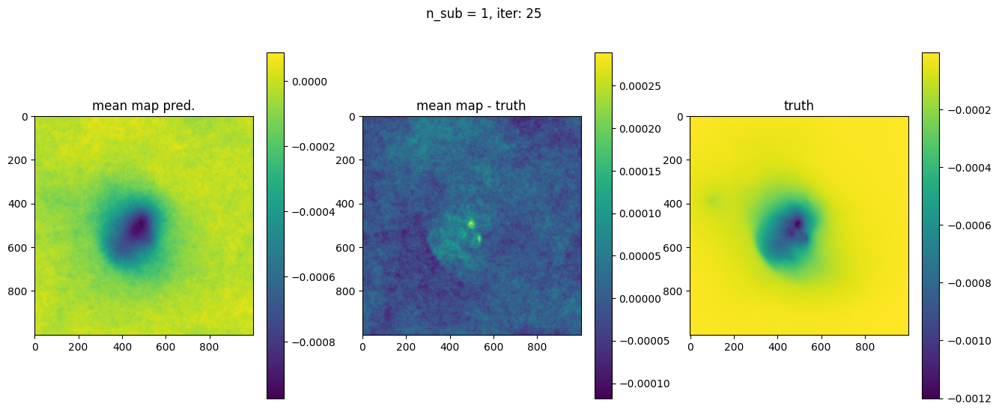

OPTIMIZE_KL: Starting 0026
SL: Iteration 0 ⛰:+9.5251e+08 Δ⛰:inf ➽:1.0601e+01
SL: Iteration 1 ⛰:+1.2817e+07 Δ⛰:9.3970e+08 ➽:1.0601e+01
SL: Iteration 2 ⛰:+6.8169e+06 Δ⛰:6.0004e+06 ➽:1.0601e+01
SL: Iteration 3 ⛰:+4.1615e+06 Δ⛰:2.6554e+06 ➽:1.0601e+01
SL: Iteration 4 ⛰:+2.1147e+06 Δ⛰:2.0468e+06 ➽:1.0601e+01
SL: Iteration 5 ⛰:+9.4830e+05 Δ⛰:1.1664e+06 ➽:1.0601e+01
SL: Iteration 6 ⛰:+7.0796e+05 Δ⛰:2.4034e+05 ➽:1.0601e+01
SL: Iteration 7 ⛰:+3.2422e+05 Δ⛰:3.8374e+05 ➽:1.0601e+01
SL: Iteration 8 ⛰:+3.2182e+05 Δ⛰:2.3958e+03 ➽:1.0601e+01
SL: Iteration 9 ⛰:+1.0610e+05 Δ⛰:2.1572e+05 ➽:1.0601e+01
SL: Iteration 10 ⛰:-1.4508e+05 Δ⛰:2.5118e+05 ➽:1.0601e+01
SL: Iteration 11 ⛰:-2.6425e+05 Δ⛰:1.1917e+05 ➽:1.0601e+01
SL: Iteration 12 ⛰:-2.9938e+05 Δ⛰:3.5134e+04 ➽:1.0601e+01
SL: Iteration 13 ⛰:-3.1500e+05 Δ⛰:1.5617e+04 ➽:1.0601e+01
SL: Iteration 14 ⛰:-3.2480e+05 Δ⛰:9.8063e+03 ➽:1.0601e+01
SL: Iteration 15 ⛰:-3.3066e+05 Δ⛰:5.8531e+03 ➽:1.0601e+01
SL: Iteration 16 ⛰:-3.8104e+05 Δ⛰:5.0380e+04 ➽:1.0601e+01
SL: 

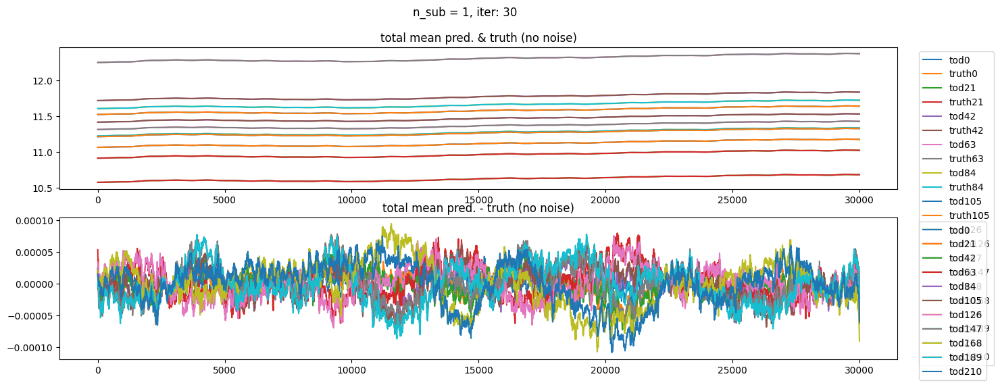

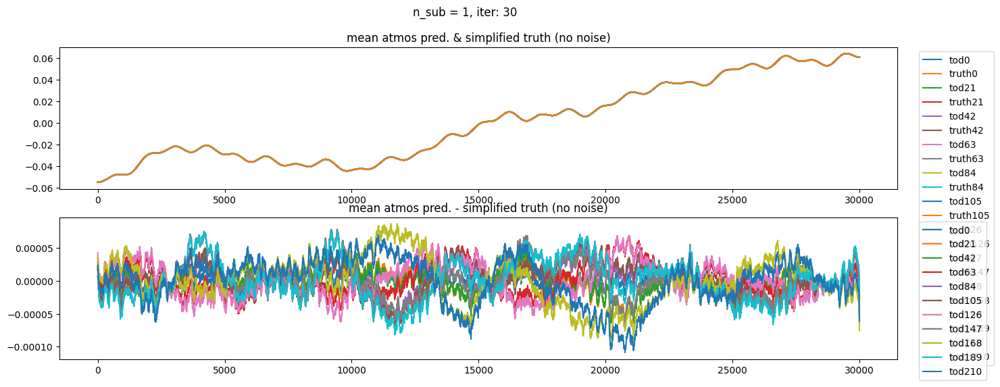

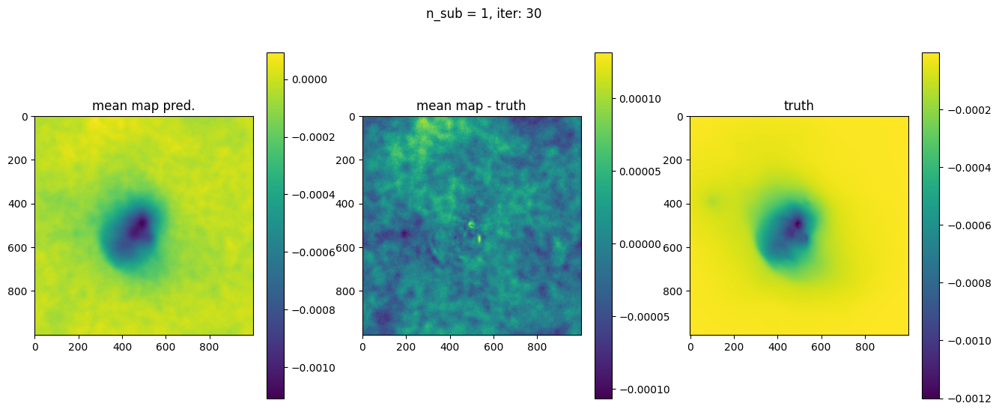

In [12]:
samples, state = fit.perform_fit(n_it=30, printevery=5)

In [13]:
fit.printfitresults(samples)

Fit Results (res, init, std) for n_sub = 1

TODs:
	fluctuations: 0.0010417585636060672, 0.0015, 0.0001
	loglogvarslope: -2.793849415221527, -2.45, 0.1
	zeromode std (LogNormal): 8.055863203117922e-07, 1e-05, 9.9e-06
map:
	fluctuations: 3.257128954902408e-05, 5.6e-05, 1e-06
	loglogvarslope: -1.9180134517687941, -2.5, 0.1
	zeromode std (LogNormal): 6.532793551998631e-10, 1e-08, 1e-07


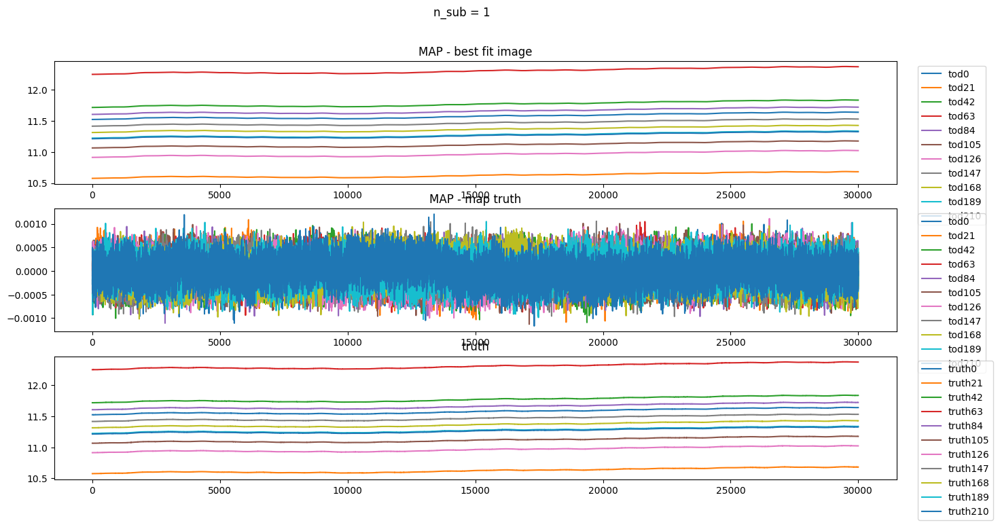

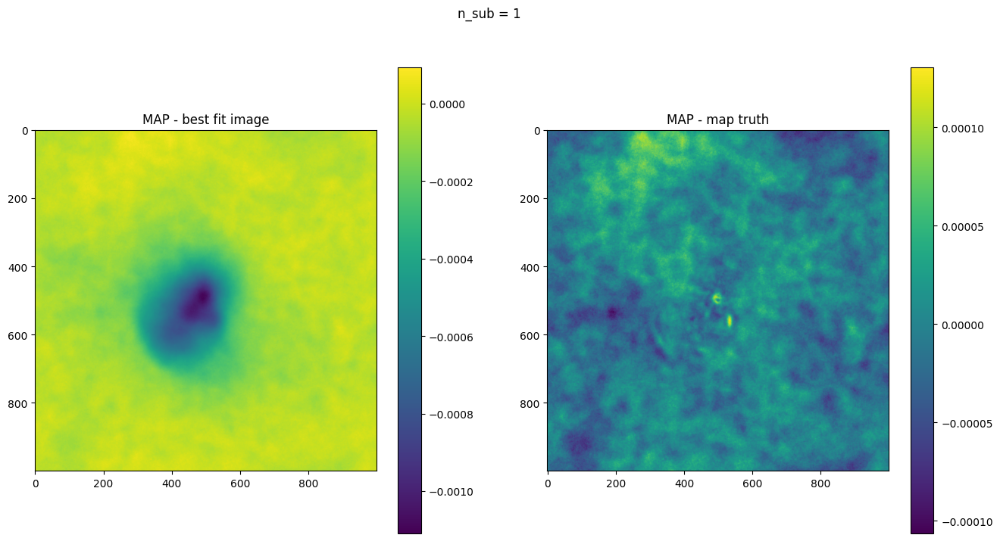

In [14]:
fit.plotfitresults(samples)

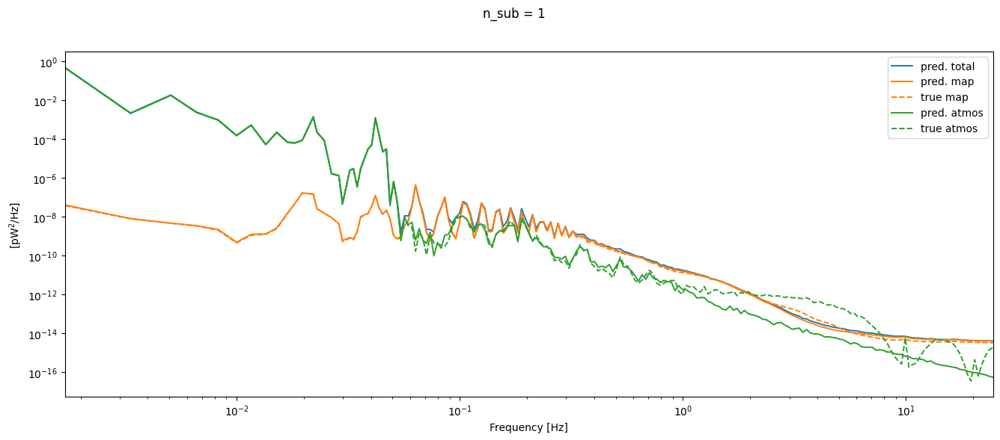

In [15]:
fit.plotpowerspectrum(samples)

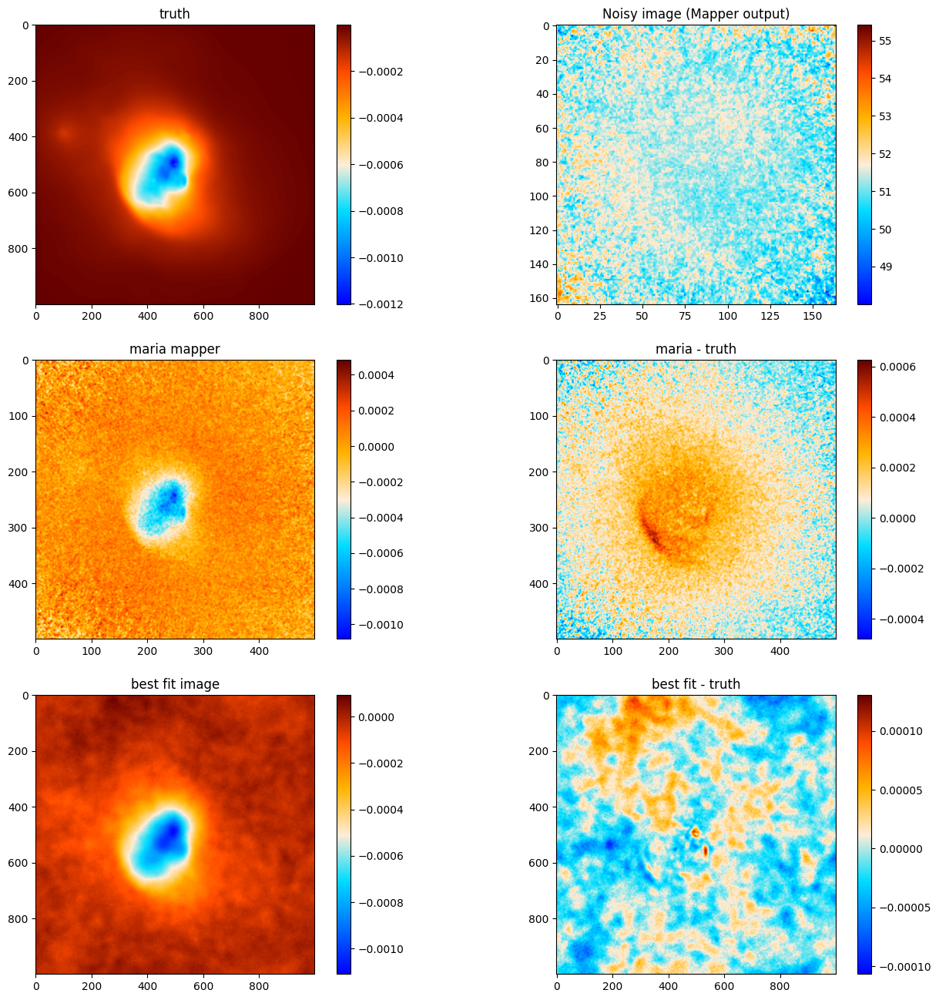

In [16]:
fit.plotrecos(samples)

# Extend det to two halves:

In [17]:
fit.init_gps(n_split=1, samples=samples)

assuming a diagonal covariance matrix;
setting `std_inv` to `cov_inv(ones_like(data))**0.5`


Initialised gp_tod: Model(
	<function CFM.finalize.<locals>.correlated_field at 0x146fecf1ce00>,
	domain={'combcf tod fluctuations': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'combcf tod loglogavgslope': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'combcf xi': ShapeWithDtype(shape=(2, 40000), dtype=<class 'jax.numpy.float64'>),
	 'combcf zeromode': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)},
	init=Initializer(
		{'combcf tod fluctuations': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'combcf tod loglogavgslope': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'combcf xi': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(2, 40000), dtype=<class 'jax.numpy.float64'>)),
		 'combcf zeromode': functools.partial(<function ra

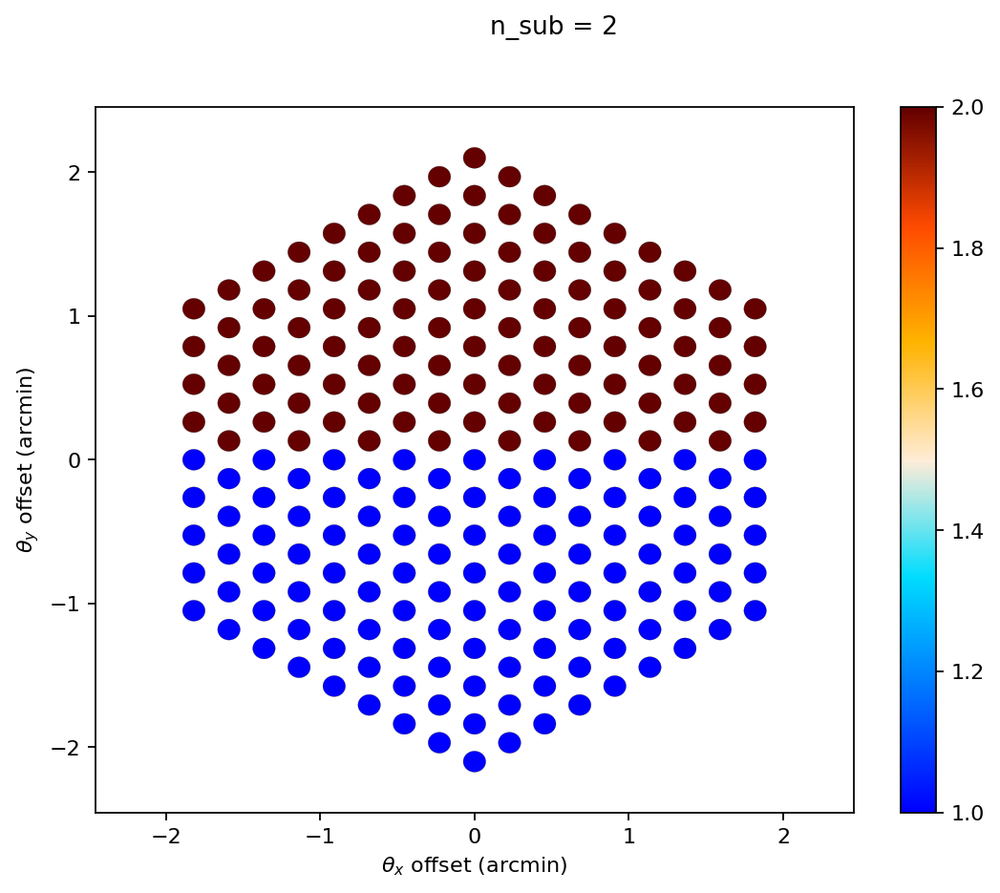

In [18]:
fit.plot_subdets()

OPTIMIZE_KL: Starting 0001


Running full fit!


SL: Iteration 0 ⛰:+1.0417e+08 Δ⛰:inf ➽:1.1001e+01
SL: Iteration 1 ⛰:+9.0229e+07 Δ⛰:1.3944e+07 ➽:1.1001e+01
SL: Iteration 2 ⛰:+9.8975e+06 Δ⛰:8.0331e+07 ➽:1.1001e+01
SL: Iteration 3 ⛰:+6.2381e+06 Δ⛰:3.6594e+06 ➽:1.1001e+01
SL: Iteration 4 ⛰:+4.5266e+06 Δ⛰:1.7115e+06 ➽:1.1001e+01
SL: Iteration 5 ⛰:+1.4795e+06 Δ⛰:3.0471e+06 ➽:1.1001e+01
SL: Iteration 6 ⛰:+1.1184e+06 Δ⛰:3.6114e+05 ➽:1.1001e+01
SL: Iteration 7 ⛰:+6.9953e+05 Δ⛰:4.1884e+05 ➽:1.1001e+01
SL: Iteration 8 ⛰:+3.6985e+05 Δ⛰:3.2968e+05 ➽:1.1001e+01
SL: Iteration 9 ⛰:+2.2978e+05 Δ⛰:1.4006e+05 ➽:1.1001e+01
SL: Iteration 10 ⛰:+8.1411e+04 Δ⛰:1.4837e+05 ➽:1.1001e+01
SL: Iteration 11 ⛰:+6.1168e+03 Δ⛰:7.5295e+04 ➽:1.1001e+01
SL: Iteration 12 ⛰:-1.3740e+05 Δ⛰:1.4352e+05 ➽:1.1001e+01
SL: Iteration 13 ⛰:-1.8690e+05 Δ⛰:4.9494e+04 ➽:1.1001e+01
SL: Iteration 14 ⛰:-2.5966e+05 Δ⛰:7.2760e+04 ➽:1.1001e+01
SL: Iteration 15 ⛰:-2.6090e+05 Δ⛰:1.2430e+03 ➽:1.1001e+01
SL: Iteration 16 ⛰:-3.1455e+05 Δ⛰:5.3651e+04 ➽:1.1001e+01
SL: Iteration 17 ⛰:-3.5337e+05 

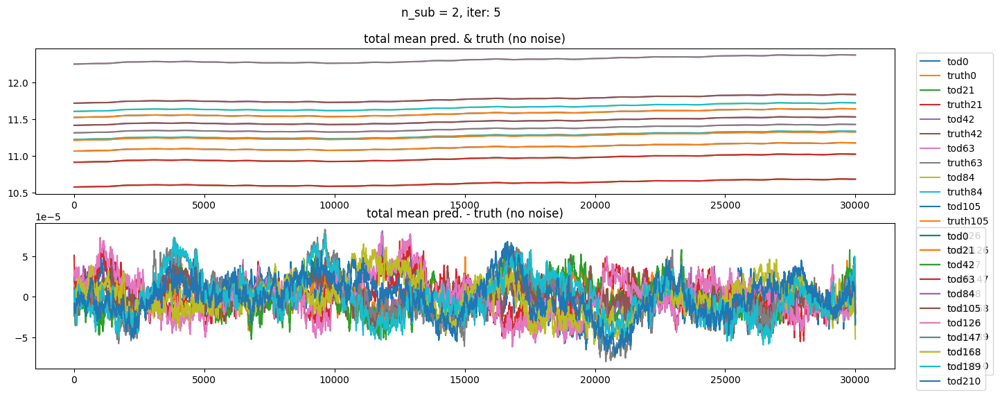

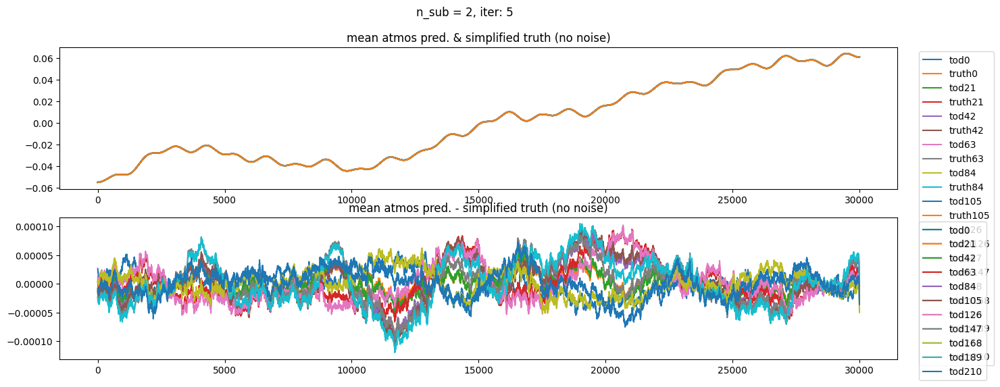

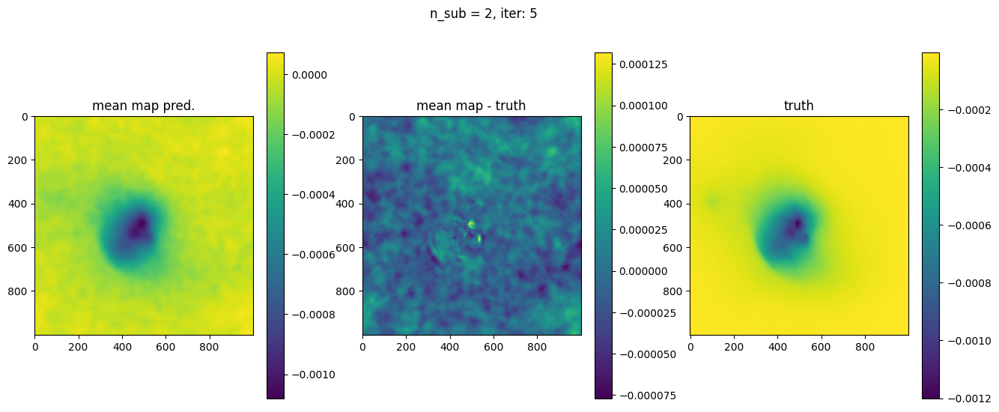

OPTIMIZE_KL: Starting 0006
SL: Iteration 0 ⛰:+3.3586e+08 Δ⛰:inf ➽:1.1001e+01
SL: Iteration 1 ⛰:+7.8451e+07 Δ⛰:2.5741e+08 ➽:1.1001e+01
SL: Iteration 2 ⛰:+1.8103e+07 Δ⛰:6.0348e+07 ➽:1.1001e+01
SL: Iteration 3 ⛰:+6.7872e+06 Δ⛰:1.1316e+07 ➽:1.1001e+01
SL: Iteration 4 ⛰:+4.9262e+06 Δ⛰:1.8610e+06 ➽:1.1001e+01
SL: Iteration 5 ⛰:+2.1027e+06 Δ⛰:2.8234e+06 ➽:1.1001e+01
SL: Iteration 6 ⛰:+1.8015e+06 Δ⛰:3.0120e+05 ➽:1.1001e+01
SL: Iteration 7 ⛰:+7.4989e+05 Δ⛰:1.0516e+06 ➽:1.1001e+01
SL: Iteration 8 ⛰:+5.0115e+05 Δ⛰:2.4874e+05 ➽:1.1001e+01
SL: Iteration 9 ⛰:+4.9720e+05 Δ⛰:3.9501e+03 ➽:1.1001e+01
SL: Iteration 10 ⛰:+2.0526e+05 Δ⛰:2.9194e+05 ➽:1.1001e+01
SL: Iteration 11 ⛰:+6.7956e+04 Δ⛰:1.3730e+05 ➽:1.1001e+01
SL: Iteration 12 ⛰:-7.9473e+04 Δ⛰:1.4743e+05 ➽:1.1001e+01
SL: Iteration 13 ⛰:-1.4661e+05 Δ⛰:6.7139e+04 ➽:1.1001e+01
SL: Iteration 14 ⛰:-2.4558e+05 Δ⛰:9.8970e+04 ➽:1.1001e+01
SL: Iteration 15 ⛰:-2.4631e+05 Δ⛰:7.2909e+02 ➽:1.1001e+01
SL: Iteration 16 ⛰:-2.4646e+05 Δ⛰:1.5168e+02 ➽:1.1001e+01
SL: 

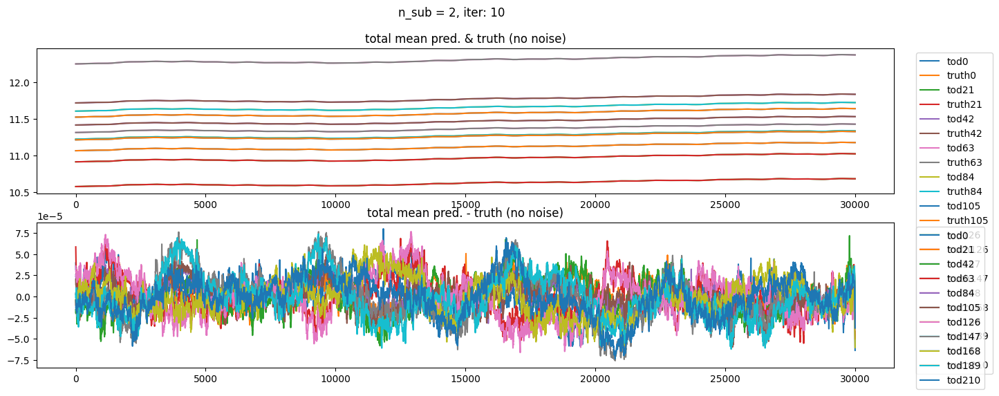

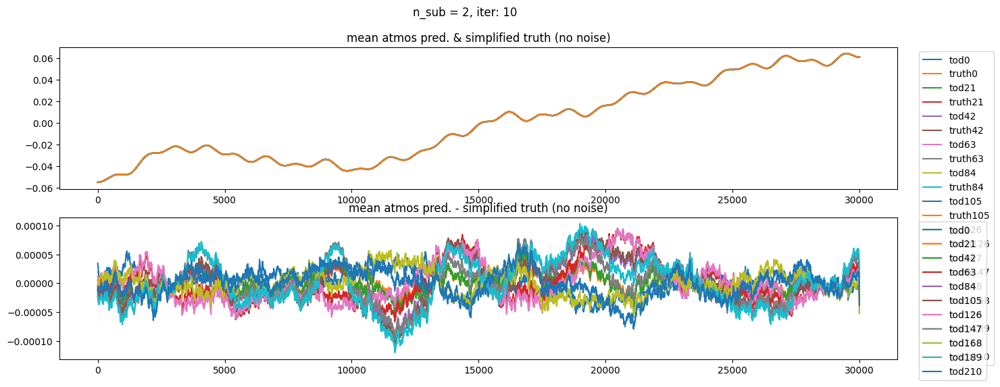

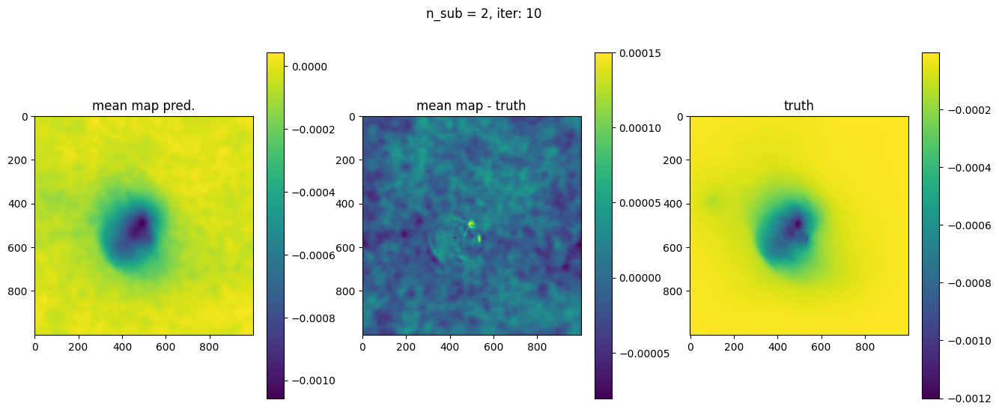

In [19]:
samples, state = fit.perform_fit(n_it=10, printevery=5)

In [20]:
fit.printfitresults(samples)

Fit Results (res, init, std) for n_sub = 2

TODs:
	fluctuations: 0.001067702712726968, 0.0015, 0.0001
	loglogvarslope: -2.8258524349679, -2.45, 0.1
	zeromode std (LogNormal): 1.4417701424576722e-06, 1e-05, 9.9e-06
map:
	fluctuations: 2.761434980388684e-05, 5.6e-05, 1e-06
	loglogvarslope: -2.2481089416139195, -2.5, 0.1
	zeromode std (LogNormal): 1.2840044283645756e-09, 1e-08, 1e-07


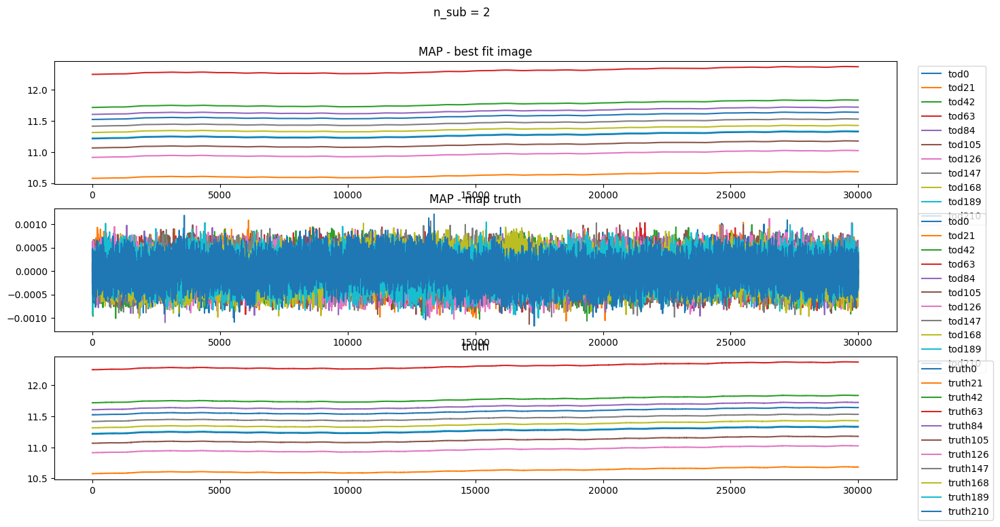

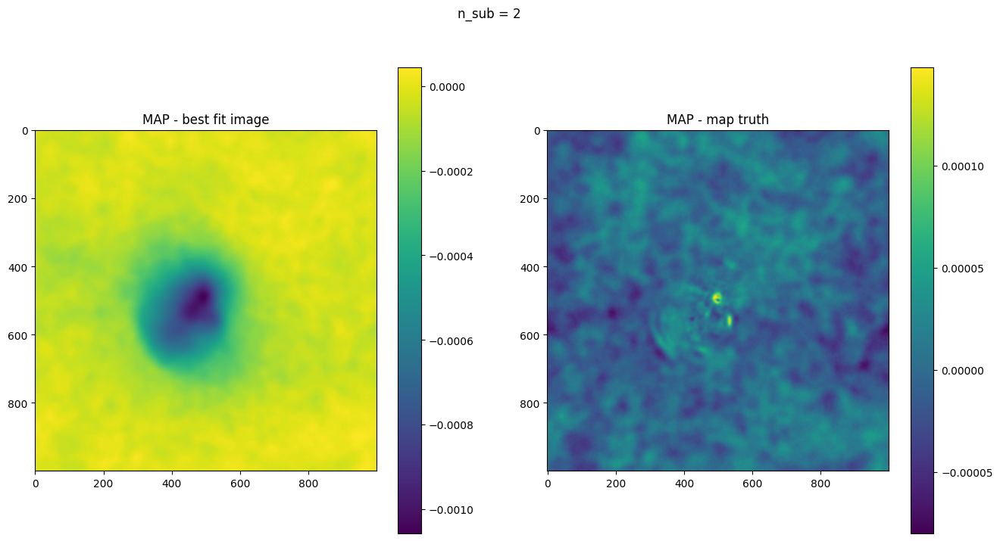

In [21]:
fit.plotfitresults(samples)

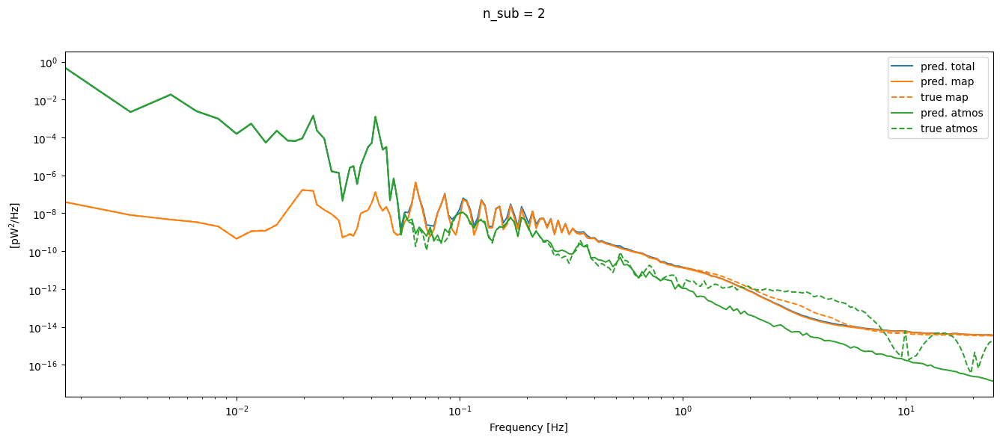

In [22]:
fit.plotpowerspectrum(samples)

# Four GPs with halved x-dir

In [23]:
fit.init_gps(n_split=2, samples=samples)

assuming a diagonal covariance matrix;
setting `std_inv` to `cov_inv(ones_like(data))**0.5`


Initialised gp_tod: Model(
	<function CFM.finalize.<locals>.correlated_field at 0x14700b750360>,
	domain={'combcf tod fluctuations': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'combcf tod loglogavgslope': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'combcf xi': ShapeWithDtype(shape=(4, 40000), dtype=<class 'jax.numpy.float64'>),
	 'combcf zeromode': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)},
	init=Initializer(
		{'combcf tod fluctuations': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'combcf tod loglogavgslope': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'combcf xi': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(4, 40000), dtype=<class 'jax.numpy.float64'>)),
		 'combcf zeromode': functools.partial(<function ra

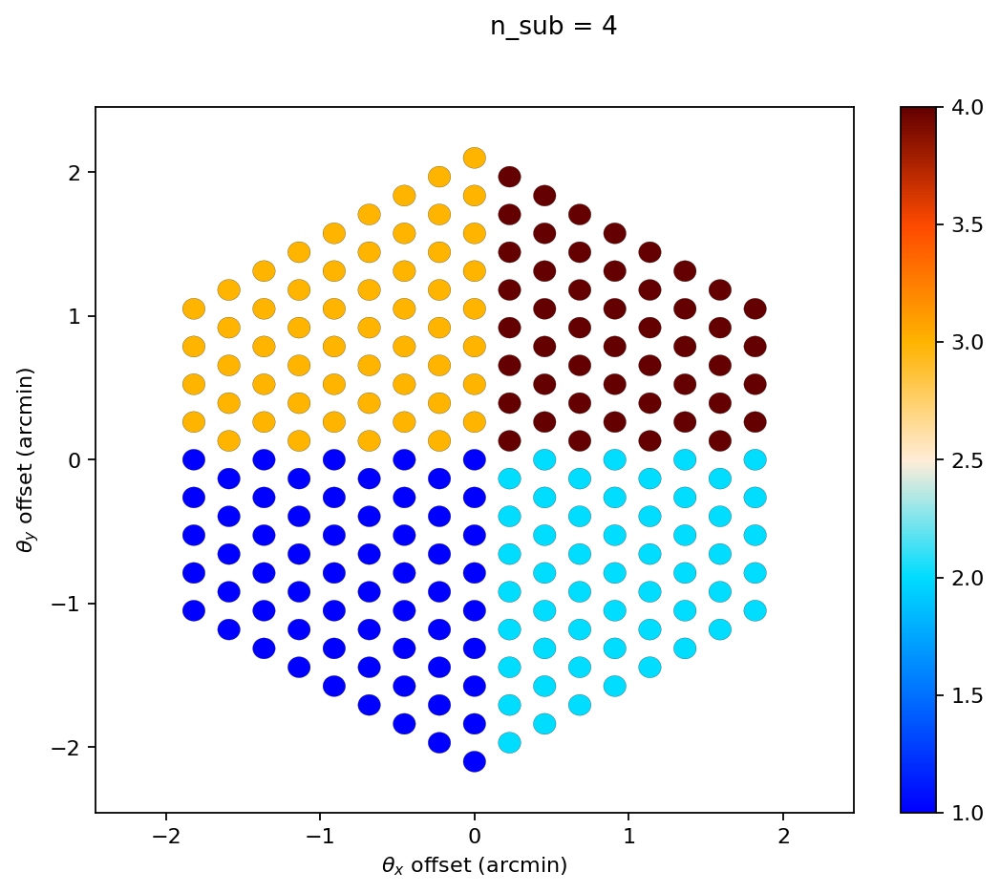

In [24]:
fit.plot_subdets()

Array([[11.5798933 , 11.57988699, 11.57988184, ..., 11.57872123,
        11.57871727, 11.57871151],
       [10.67390427, 10.67390614, 10.67390775, ..., 10.67500972,
        10.67501099, 10.67501403],
       [10.98463141, 10.98463271, 10.9846348 , ..., 10.98539688,
        10.98539875, 10.98540011],
       ...,
       [11.67804158, 11.67804309, 11.67804519, ..., 11.68125236,
        11.68125079, 11.6812482 ],
       [11.5218183 , 11.52181326, 11.52180918, ..., 11.52066303,
        11.52066   , 11.52065519],
       [10.6513212 , 10.6513136 , 10.65130989, ..., 10.65026456,
        10.65026304, 10.65026047]], dtype=float64)

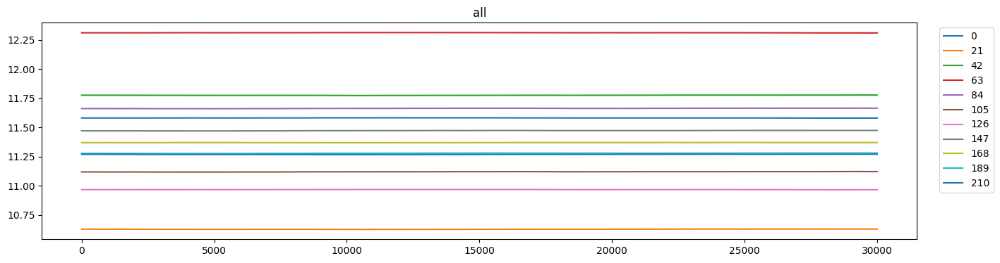

In [25]:
fit.draw_prior_sample()

OPTIMIZE_KL: Starting 0001


Running full fit!


SL: Iteration 0 ⛰:+7.4901e+08 Δ⛰:inf ➽:1.1801e+01
SL: Iteration 1 ⛰:+6.1852e+07 Δ⛰:6.8715e+08 ➽:1.1801e+01
SL: Iteration 2 ⛰:+1.0330e+07 Δ⛰:5.1523e+07 ➽:1.1801e+01
SL: Iteration 3 ⛰:+8.4549e+06 Δ⛰:1.8748e+06 ➽:1.1801e+01
SL: Iteration 4 ⛰:+5.1525e+06 Δ⛰:3.3024e+06 ➽:1.1801e+01
SL: Iteration 5 ⛰:+2.1671e+06 Δ⛰:2.9854e+06 ➽:1.1801e+01
SL: Iteration 6 ⛰:+1.4033e+06 Δ⛰:7.6381e+05 ➽:1.1801e+01
SL: Iteration 7 ⛰:+1.1222e+06 Δ⛰:2.8102e+05 ➽:1.1801e+01
SL: Iteration 8 ⛰:+6.3902e+05 Δ⛰:4.8321e+05 ➽:1.1801e+01
SL: Iteration 9 ⛰:+5.9618e+05 Δ⛰:4.2839e+04 ➽:1.1801e+01
SL: Iteration 10 ⛰:+4.6893e+05 Δ⛰:1.2726e+05 ➽:1.1801e+01
SL: Iteration 11 ⛰:+2.4299e+05 Δ⛰:2.2594e+05 ➽:1.1801e+01
SL: Iteration 12 ⛰:+1.6598e+05 Δ⛰:7.7005e+04 ➽:1.1801e+01
SL: Iteration 13 ⛰:+5.6230e+04 Δ⛰:1.0975e+05 ➽:1.1801e+01
SL: Iteration 14 ⛰:-7.8041e+04 Δ⛰:1.3427e+05 ➽:1.1801e+01
SL: Iteration 15 ⛰:-2.0073e+05 Δ⛰:1.2269e+05 ➽:1.1801e+01
SL: Iteration 16 ⛰:-2.0094e+05 Δ⛰:2.0795e+02 ➽:1.1801e+01
SL: Iteration 17 ⛰:-2.6313e+05 

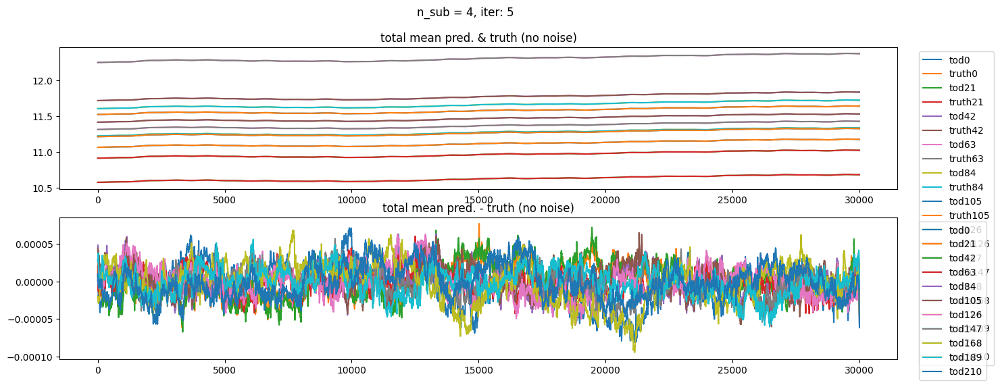

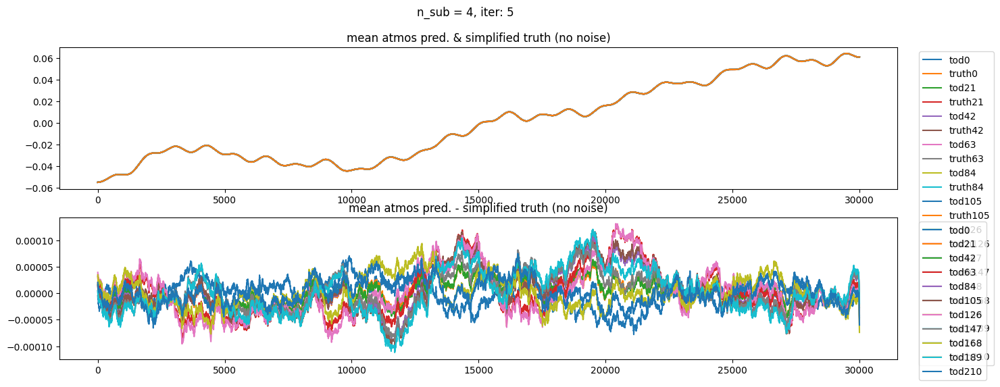

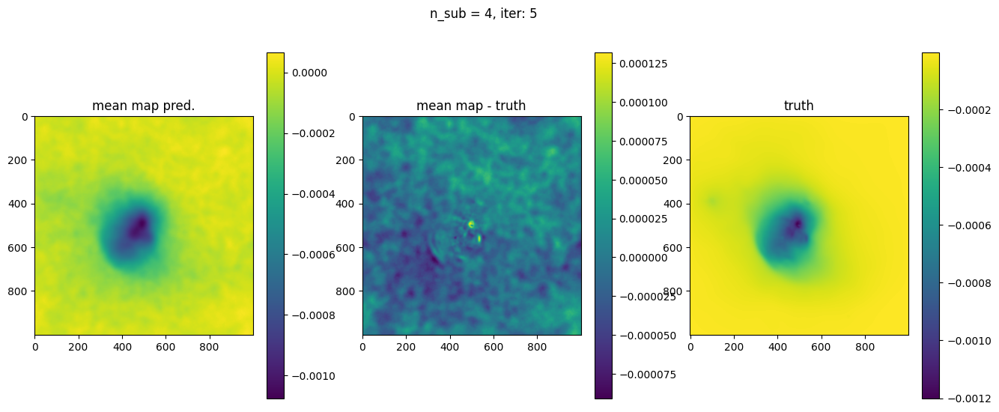

OPTIMIZE_KL: Starting 0006
SL: Iteration 0 ⛰:+5.0696e+08 Δ⛰:inf ➽:1.1801e+01
SL: Iteration 1 ⛰:+6.6193e+07 Δ⛰:4.4076e+08 ➽:1.1801e+01
SL: Iteration 2 ⛰:+2.9553e+07 Δ⛰:3.6640e+07 ➽:1.1801e+01
SL: Iteration 3 ⛰:+1.0588e+07 Δ⛰:1.8964e+07 ➽:1.1801e+01
SL: Iteration 4 ⛰:+6.4321e+06 Δ⛰:4.1563e+06 ➽:1.1801e+01
SL: Iteration 5 ⛰:+2.5918e+06 Δ⛰:3.8403e+06 ➽:1.1801e+01
SL: Iteration 6 ⛰:+1.8597e+06 Δ⛰:7.3208e+05 ➽:1.1801e+01
SL: Iteration 7 ⛰:+1.4912e+06 Δ⛰:3.6852e+05 ➽:1.1801e+01
SL: Iteration 8 ⛰:+7.6417e+05 Δ⛰:7.2703e+05 ➽:1.1801e+01
SL: Iteration 9 ⛰:+7.5734e+05 Δ⛰:6.8293e+03 ➽:1.1801e+01
SL: Iteration 10 ⛰:+6.2802e+05 Δ⛰:1.2932e+05 ➽:1.1801e+01
SL: Iteration 11 ⛰:+2.4329e+05 Δ⛰:3.8472e+05 ➽:1.1801e+01
SL: Iteration 12 ⛰:+1.7621e+05 Δ⛰:6.7085e+04 ➽:1.1801e+01
SL: Iteration 13 ⛰:-4.5622e+04 Δ⛰:2.2183e+05 ➽:1.1801e+01
SL: Iteration 14 ⛰:-8.9331e+04 Δ⛰:4.3709e+04 ➽:1.1801e+01
SL: Iteration 15 ⛰:-1.5787e+05 Δ⛰:6.8543e+04 ➽:1.1801e+01
SL: Iteration 16 ⛰:-1.5944e+05 Δ⛰:1.5694e+03 ➽:1.1801e+01
SL: 

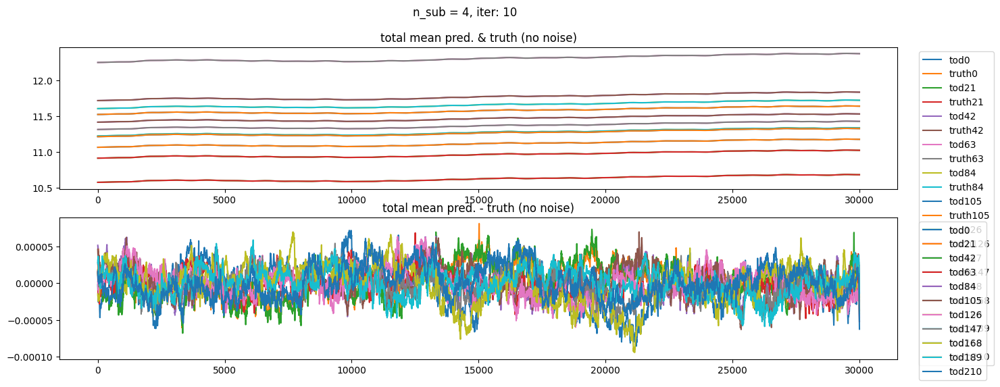

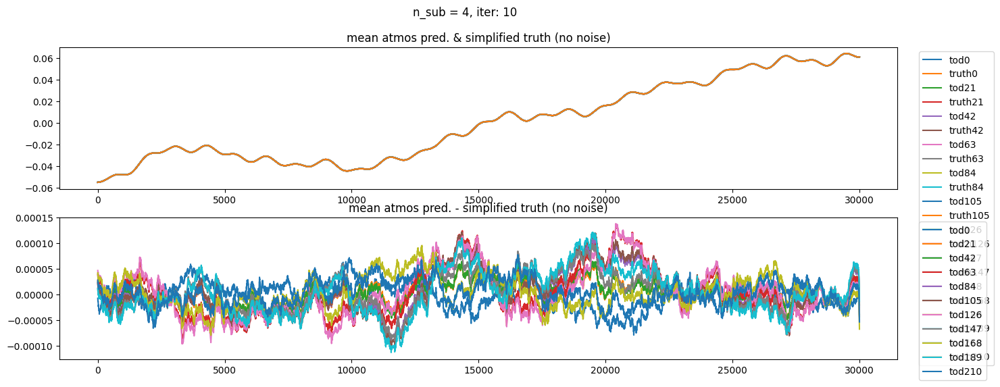

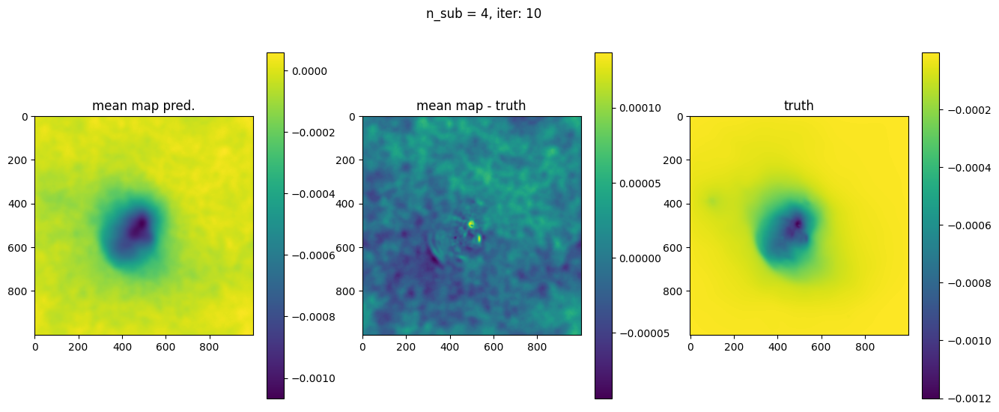

In [26]:
samples, state = fit.perform_fit(n_it=10, printevery=5)

In [27]:
fit.printfitresults(samples)

Fit Results (res, init, std) for n_sub = 4

TODs:
	fluctuations: 0.0010254884692490755, 0.0015, 0.0001
	loglogvarslope: -2.796665614504461, -2.45, 0.1
	zeromode std (LogNormal): 1.7562931295907472e-06, 1e-05, 9.9e-06
map:
	fluctuations: 2.6891929270289547e-05, 5.6e-05, 1e-06
	loglogvarslope: -2.4270153628348763, -2.5, 0.1
	zeromode std (LogNormal): 9.998004138615556e-10, 1e-08, 1e-07


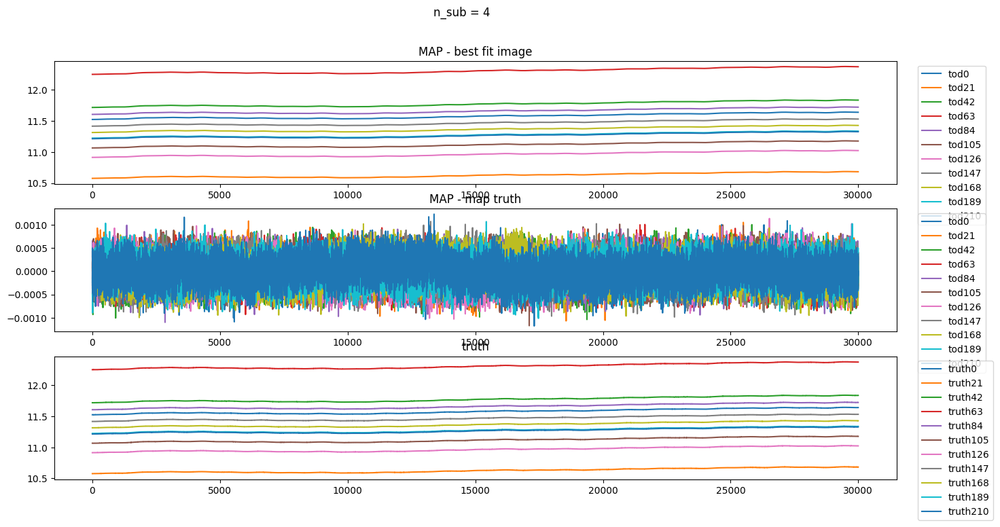

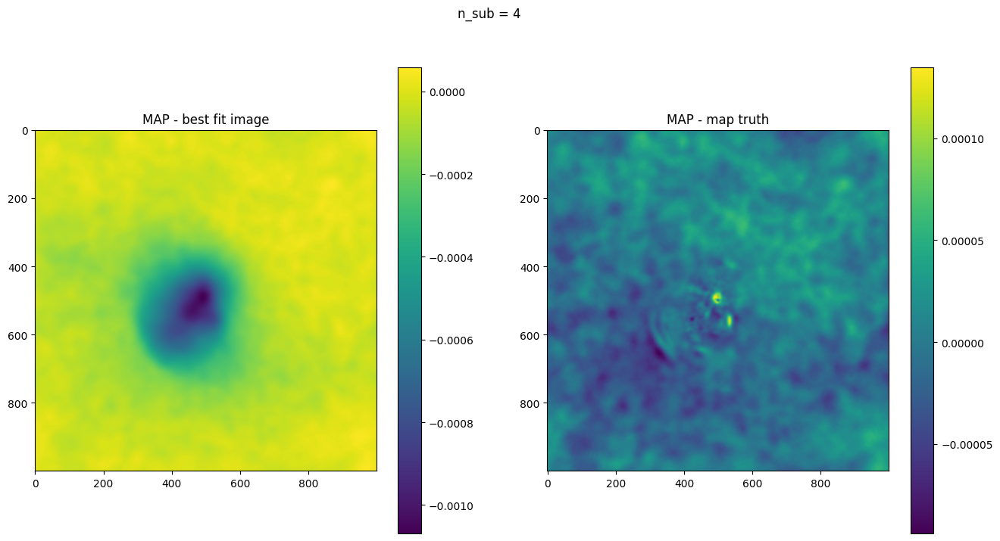

In [28]:
fit.plotfitresults(samples)

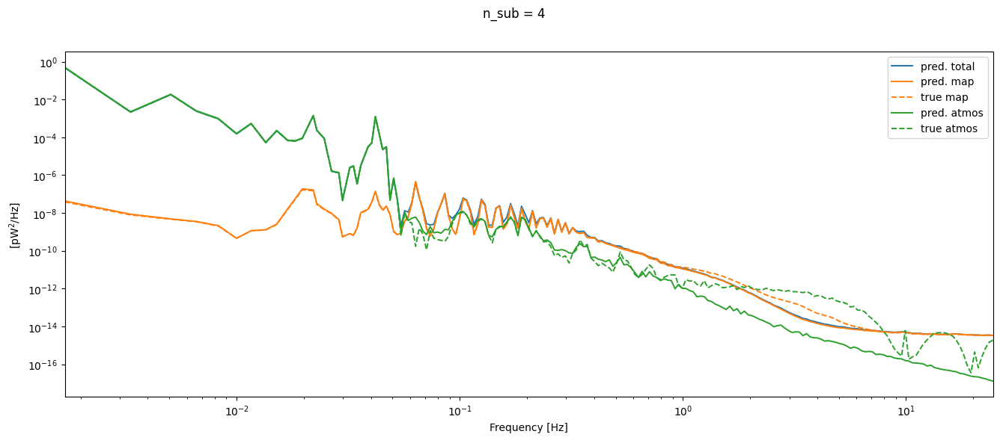

In [29]:
fit.plotpowerspectrum(samples)

# All dets.

In [30]:
fit.init_gps(n_split=-1, samples=samples)

assuming a diagonal covariance matrix;
setting `std_inv` to `cov_inv(ones_like(data))**0.5`


Initialised gp_tod: Model(
	<function CFM.finalize.<locals>.correlated_field at 0x146fecac05e0>,
	domain={'combcf tod fluctuations': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'combcf tod loglogavgslope': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'combcf xi': ShapeWithDtype(shape=(217, 40000), dtype=<class 'jax.numpy.float64'>),
	 'combcf zeromode': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)},
	init=Initializer(
		{'combcf tod fluctuations': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'combcf tod loglogavgslope': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'combcf xi': functools.partial(<function random_like at 0x147740c2e3e0>, primals=ShapeWithDtype(shape=(217, 40000), dtype=<class 'jax.numpy.float64'>)),
		 'combcf zeromode': functools.partial(<functio

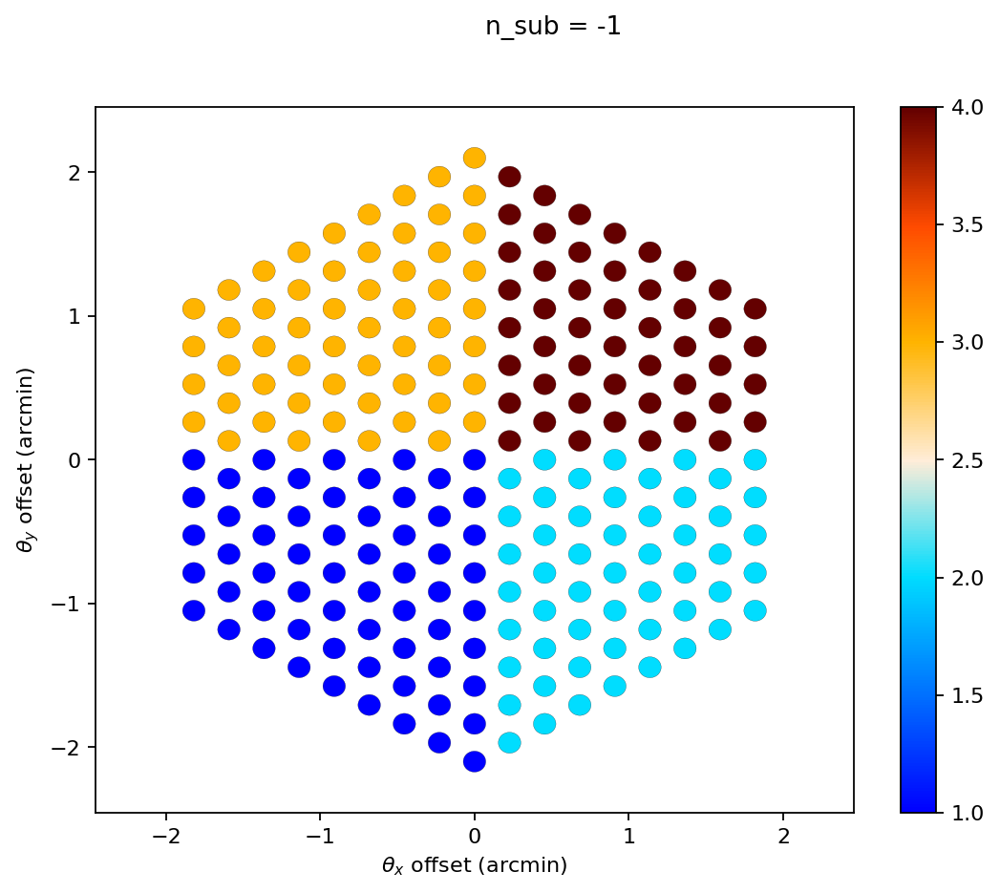

In [31]:
fit.plot_subdets()

OPTIMIZE_KL: Starting 0001


Running full fit!


SL: Iteration 0 ⛰:+7.2595e+07 Δ⛰:inf ➽:9.7001e+01
SL: Iteration 1 ⛰:+4.6819e+07 Δ⛰:2.5776e+07 ➽:9.7001e+01
SL: Iteration 2 ⛰:+4.5535e+07 Δ⛰:1.2844e+06 ➽:9.7001e+01
SL: Iteration 3 ⛰:+4.9484e+06 Δ⛰:4.0586e+07 ➽:9.7001e+01
SL: Iteration 4 ⛰:+1.6788e+06 Δ⛰:3.2697e+06 ➽:9.7001e+01
SL: Iteration 5 ⛰:-6.9662e+05 Δ⛰:2.3754e+06 ➽:9.7001e+01
SL: Iteration 6 ⛰:-2.3391e+06 Δ⛰:1.6425e+06 ➽:9.7001e+01
SL: Iteration 7 ⛰:-2.3400e+06 Δ⛰:9.2984e+02 ➽:9.7001e+01
SL: Iteration 8 ⛰:-2.6257e+06 Δ⛰:2.8570e+05 ➽:9.7001e+01
SL: Iteration 9 ⛰:-2.8128e+06 Δ⛰:1.8711e+05 ➽:9.7001e+01
SL: Iteration 10 ⛰:-2.9526e+06 Δ⛰:1.3972e+05 ➽:9.7001e+01
SL: Iteration 11 ⛰:-3.5627e+06 Δ⛰:6.1013e+05 ➽:9.7001e+01
SL: Iteration 12 ⛰:-3.7225e+06 Δ⛰:1.5982e+05 ➽:9.7001e+01
SL: Iteration 13 ⛰:-3.7309e+06 Δ⛰:8.3491e+03 ➽:9.7001e+01
SL: Iteration 14 ⛰:-3.8424e+06 Δ⛰:1.1159e+05 ➽:9.7001e+01
SL: Iteration 15 ⛰:-4.0058e+06 Δ⛰:1.6331e+05 ➽:9.7001e+01
SL: Iteration 16 ⛰:-4.0550e+06 Δ⛰:4.9222e+04 ➽:9.7001e+01
SL: Iteration 17 ⛰:-4.0606e+06 

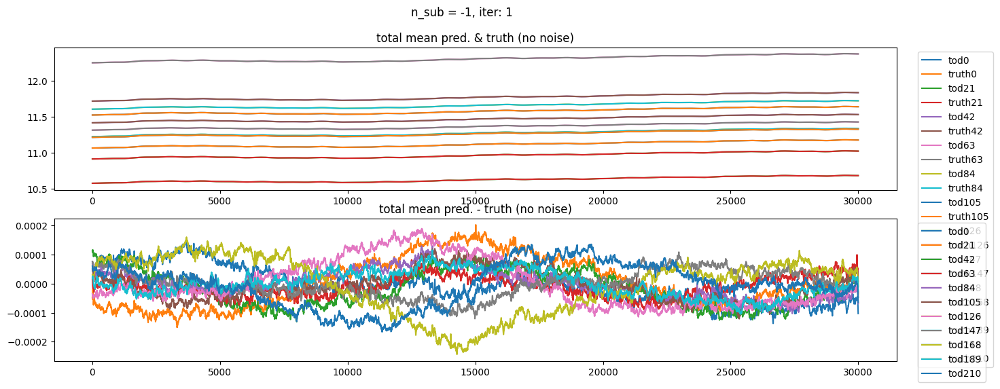

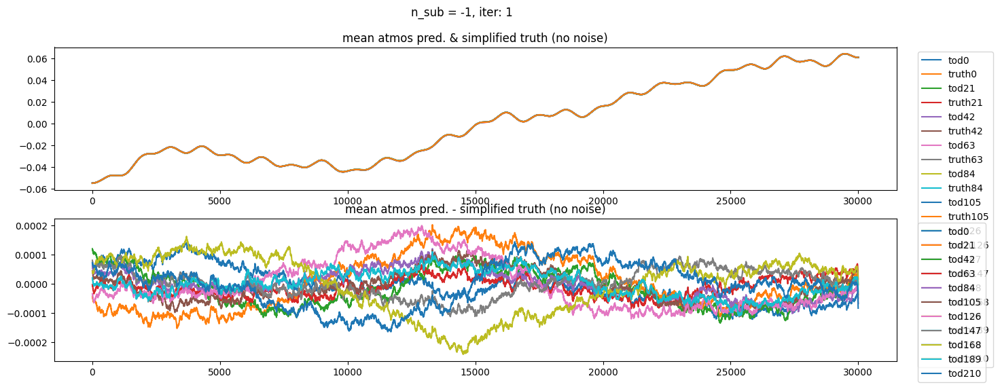

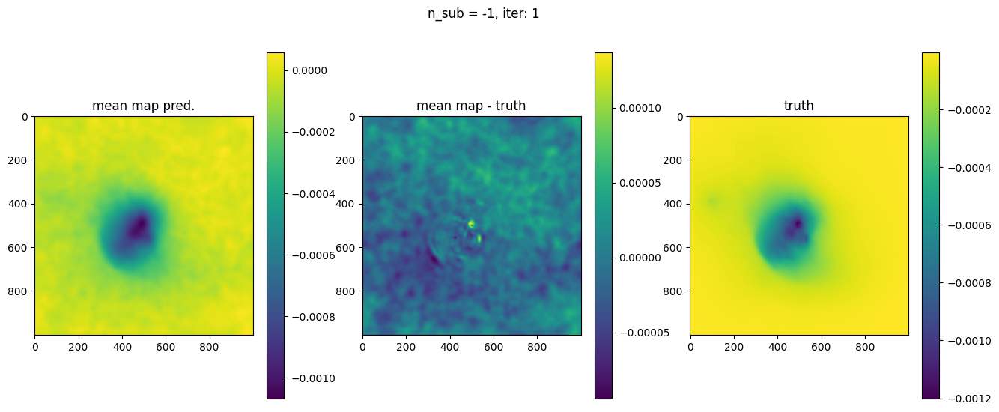

OPTIMIZE_KL: Starting 0002
SL: Iteration 0 ⛰:+1.3325e+08 Δ⛰:inf ➽:9.7001e+01
SL: Iteration 1 ⛰:+5.3742e+07 Δ⛰:7.9512e+07 ➽:9.7001e+01
SL: Iteration 2 ⛰:+4.9288e+07 Δ⛰:4.4536e+06 ➽:9.7001e+01
SL: Iteration 3 ⛰:+5.3172e+06 Δ⛰:4.3971e+07 ➽:9.7001e+01
SL: Iteration 4 ⛰:+1.7574e+06 Δ⛰:3.5598e+06 ➽:9.7001e+01
SL: Iteration 5 ⛰:-6.7351e+05 Δ⛰:2.4309e+06 ➽:9.7001e+01
SL: Iteration 6 ⛰:-1.1368e+06 Δ⛰:4.6329e+05 ➽:9.7001e+01
SL: Iteration 7 ⛰:-2.4171e+06 Δ⛰:1.2803e+06 ➽:9.7001e+01
SL: Iteration 8 ⛰:-2.6932e+06 Δ⛰:2.7610e+05 ➽:9.7001e+01
SL: Iteration 9 ⛰:-2.7026e+06 Δ⛰:9.4072e+03 ➽:9.7001e+01
SL: Iteration 10 ⛰:-3.0159e+06 Δ⛰:3.1335e+05 ➽:9.7001e+01
SL: Iteration 11 ⛰:-3.5934e+06 Δ⛰:5.7746e+05 ➽:9.7001e+01
SL: Iteration 12 ⛰:-3.5936e+06 Δ⛰:1.6458e+02 ➽:9.7001e+01
SL: Iteration 13 ⛰:-3.7446e+06 Δ⛰:1.5104e+05 ➽:9.7001e+01
SL: Iteration 14 ⛰:-3.8428e+06 Δ⛰:9.8176e+04 ➽:9.7001e+01
SL: Iteration 15 ⛰:-3.9981e+06 Δ⛰:1.5532e+05 ➽:9.7001e+01
SL: Iteration 16 ⛰:-4.0527e+06 Δ⛰:5.4576e+04 ➽:9.7001e+01
SL: 

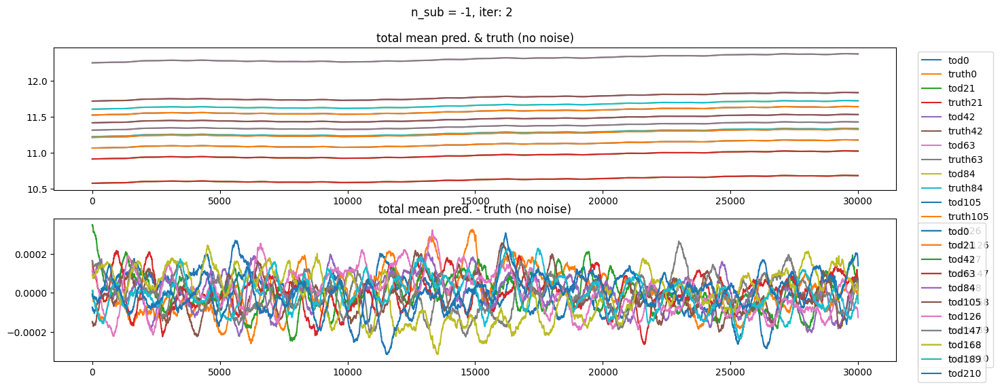

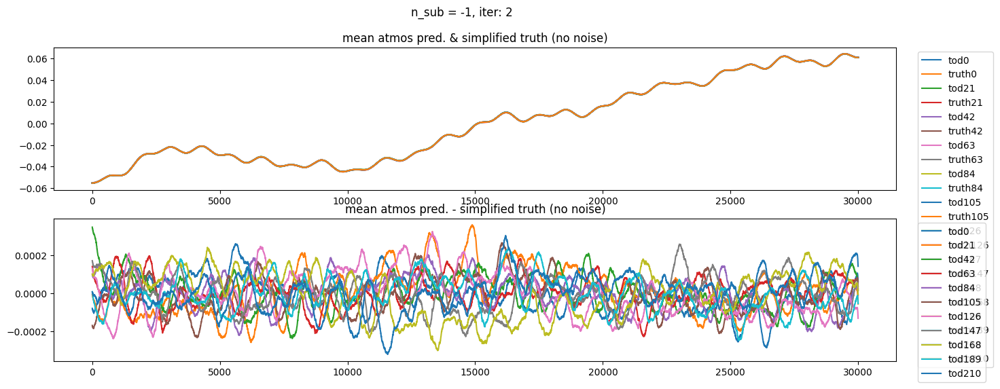

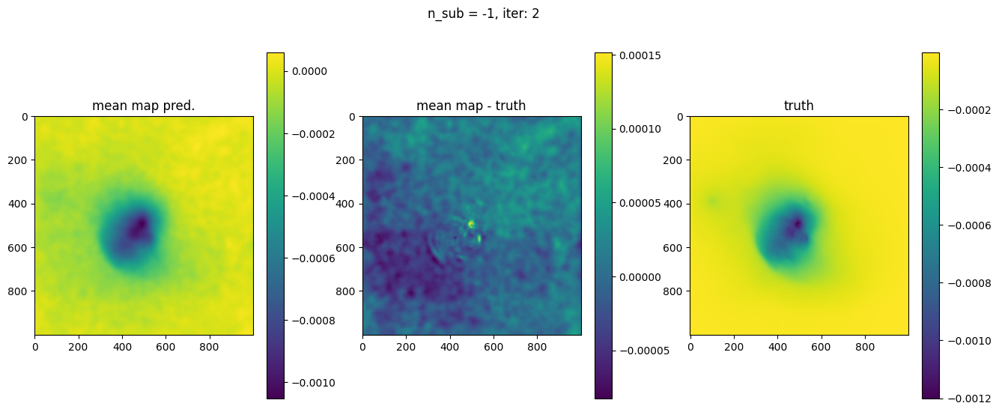

OPTIMIZE_KL: Starting 0003
SL: Iteration 0 ⛰:+6.0077e+08 Δ⛰:inf ➽:9.7001e+01
SL: Iteration 1 ⛰:+9.3332e+07 Δ⛰:5.0743e+08 ➽:9.7001e+01
SL: Iteration 2 ⛰:+6.0029e+07 Δ⛰:3.3303e+07 ➽:9.7001e+01
SL: Iteration 3 ⛰:+7.7954e+06 Δ⛰:5.2234e+07 ➽:9.7001e+01
SL: Iteration 4 ⛰:+3.6140e+06 Δ⛰:4.1814e+06 ➽:9.7001e+01
SL: Iteration 5 ⛰:+1.8845e+05 Δ⛰:3.4256e+06 ➽:9.7001e+01
SL: Iteration 6 ⛰:-7.6198e+05 Δ⛰:9.5043e+05 ➽:9.7001e+01
SL: Iteration 7 ⛰:-1.6901e+06 Δ⛰:9.2808e+05 ➽:9.7001e+01
SL: Iteration 8 ⛰:-2.0181e+06 Δ⛰:3.2805e+05 ➽:9.7001e+01
SL: Iteration 9 ⛰:-2.1891e+06 Δ⛰:1.7100e+05 ➽:9.7001e+01
SL: Iteration 10 ⛰:-2.5245e+06 Δ⛰:3.3544e+05 ➽:9.7001e+01
SL: Iteration 11 ⛰:-3.1982e+06 Δ⛰:6.7361e+05 ➽:9.7001e+01
SL: Iteration 12 ⛰:-3.3278e+06 Δ⛰:1.2961e+05 ➽:9.7001e+01
SL: Iteration 13 ⛰:-3.3648e+06 Δ⛰:3.6995e+04 ➽:9.7001e+01
SL: Iteration 14 ⛰:-3.5106e+06 Δ⛰:1.4582e+05 ➽:9.7001e+01
SL: Iteration 15 ⛰:-3.6921e+06 Δ⛰:1.8151e+05 ➽:9.7001e+01
SL: Iteration 16 ⛰:-3.7511e+06 Δ⛰:5.9021e+04 ➽:9.7001e+01
SL: 

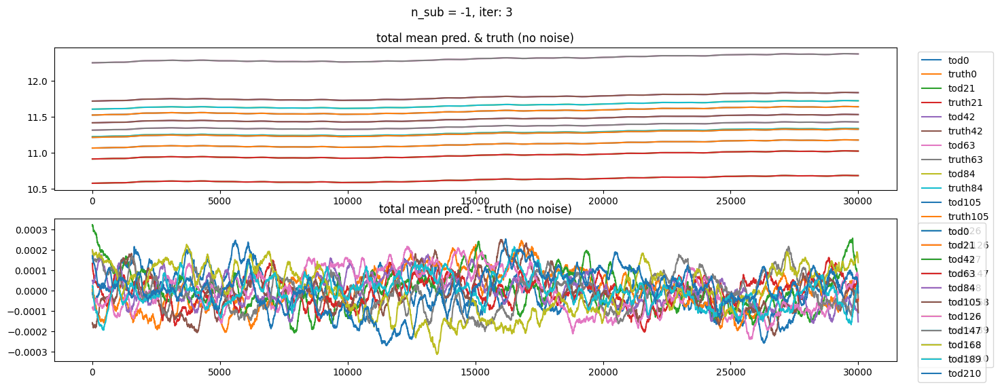

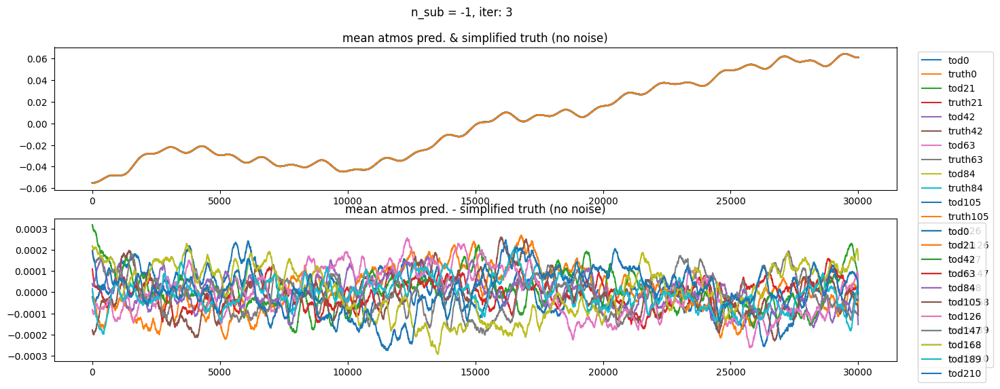

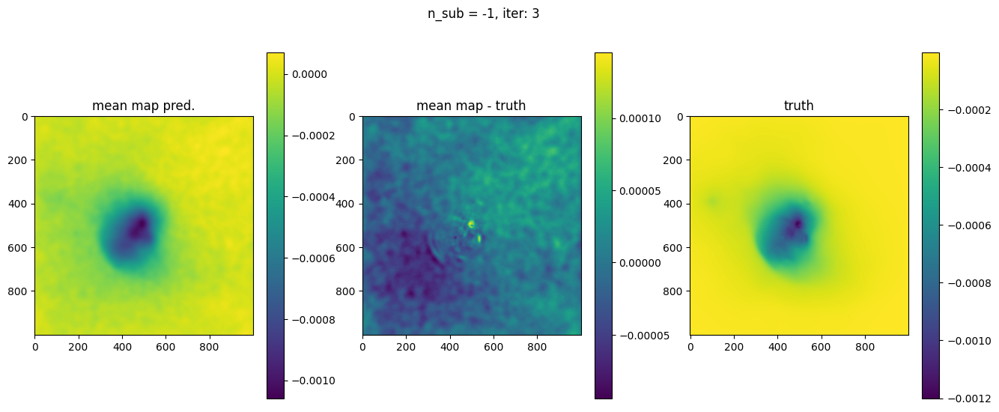

OPTIMIZE_KL: Starting 0004
SL: Iteration 0 ⛰:+1.4154e+08 Δ⛰:inf ➽:9.7001e+01
SL: Iteration 1 ⛰:+9.2768e+07 Δ⛰:4.8771e+07 ➽:9.7001e+01
SL: Iteration 2 ⛰:+6.9030e+07 Δ⛰:2.3737e+07 ➽:9.7001e+01
SL: Iteration 3 ⛰:+1.0684e+07 Δ⛰:5.8346e+07 ➽:9.7001e+01
SL: Iteration 4 ⛰:+5.6550e+06 Δ⛰:5.0291e+06 ➽:9.7001e+01
SL: Iteration 5 ⛰:+1.7339e+06 Δ⛰:3.9211e+06 ➽:9.7001e+01
SL: Iteration 6 ⛰:-7.7354e+05 Δ⛰:2.5074e+06 ➽:9.7001e+01
SL: Iteration 7 ⛰:-7.7465e+05 Δ⛰:1.1108e+03 ➽:9.7001e+01
SL: Iteration 8 ⛰:-1.2063e+06 Δ⛰:4.3165e+05 ➽:9.7001e+01
SL: Iteration 9 ⛰:-1.4930e+06 Δ⛰:2.8667e+05 ➽:9.7001e+01
SL: Iteration 10 ⛰:-1.8537e+06 Δ⛰:3.6069e+05 ➽:9.7001e+01
SL: Iteration 11 ⛰:-2.7245e+06 Δ⛰:8.7086e+05 ➽:9.7001e+01
SL: Iteration 12 ⛰:-2.9788e+06 Δ⛰:2.5426e+05 ➽:9.7001e+01
SL: Iteration 13 ⛰:-2.9791e+06 Δ⛰:3.2138e+02 ➽:9.7001e+01
SL: Iteration 14 ⛰:-3.1613e+06 Δ⛰:1.8223e+05 ➽:9.7001e+01
SL: Iteration 15 ⛰:-3.4207e+06 Δ⛰:2.5932e+05 ➽:9.7001e+01
SL: Iteration 16 ⛰:-3.5107e+06 Δ⛰:8.9993e+04 ➽:9.7001e+01
SL: 

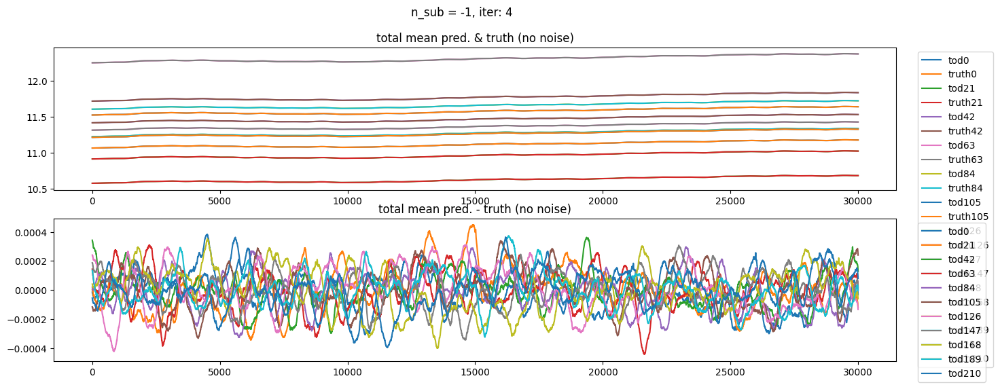

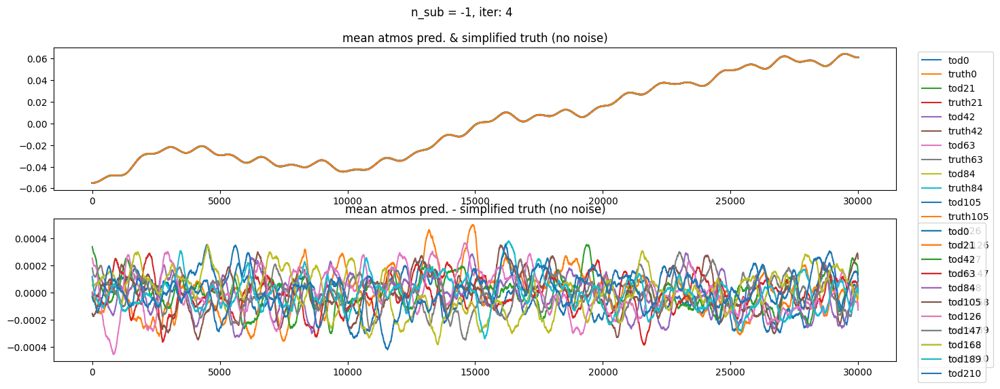

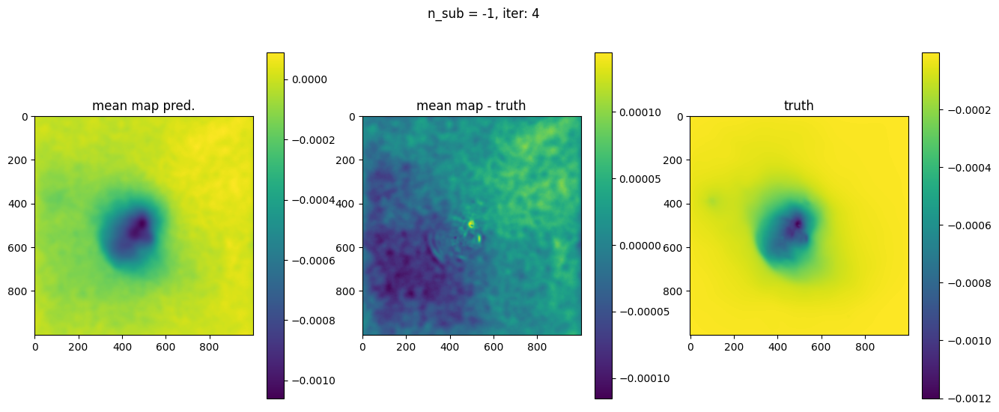

OPTIMIZE_KL: Starting 0005
SL: Iteration 0 ⛰:+5.9092e+08 Δ⛰:inf ➽:9.7001e+01
SL: Iteration 1 ⛰:+1.1282e+08 Δ⛰:4.7809e+08 ➽:9.7001e+01
SL: Iteration 2 ⛰:+8.6390e+07 Δ⛰:2.6432e+07 ➽:9.7001e+01
SL: Iteration 3 ⛰:+1.3427e+07 Δ⛰:7.2963e+07 ➽:9.7001e+01
SL: Iteration 4 ⛰:+7.4763e+06 Δ⛰:5.9507e+06 ➽:9.7001e+01
SL: Iteration 5 ⛰:+2.8998e+06 Δ⛰:4.5764e+06 ➽:9.7001e+01
SL: Iteration 6 ⛰:+1.8055e+06 Δ⛰:1.0944e+06 ➽:9.7001e+01
SL: Iteration 7 ⛰:+8.7050e+04 Δ⛰:1.7184e+06 ➽:9.7001e+01
SL: Iteration 8 ⛰:-4.1973e+05 Δ⛰:5.0678e+05 ➽:9.7001e+01
SL: Iteration 9 ⛰:-1.2049e+06 Δ⛰:7.8519e+05 ➽:9.7001e+01
SL: Iteration 10 ⛰:-1.2314e+06 Δ⛰:2.6474e+04 ➽:9.7001e+01
SL: Iteration 11 ⛰:-2.3158e+06 Δ⛰:1.0844e+06 ➽:9.7001e+01
SL: Iteration 12 ⛰:-2.3284e+06 Δ⛰:1.2656e+04 ➽:9.7001e+01
SL: Iteration 13 ⛰:-2.5817e+06 Δ⛰:2.5330e+05 ➽:9.7001e+01
SL: Iteration 14 ⛰:-2.8084e+06 Δ⛰:2.2671e+05 ➽:9.7001e+01
SL: Iteration 15 ⛰:-3.0867e+06 Δ⛰:2.7825e+05 ➽:9.7001e+01
SL: Iteration 16 ⛰:-3.1728e+06 Δ⛰:8.6104e+04 ➽:9.7001e+01
SL: 

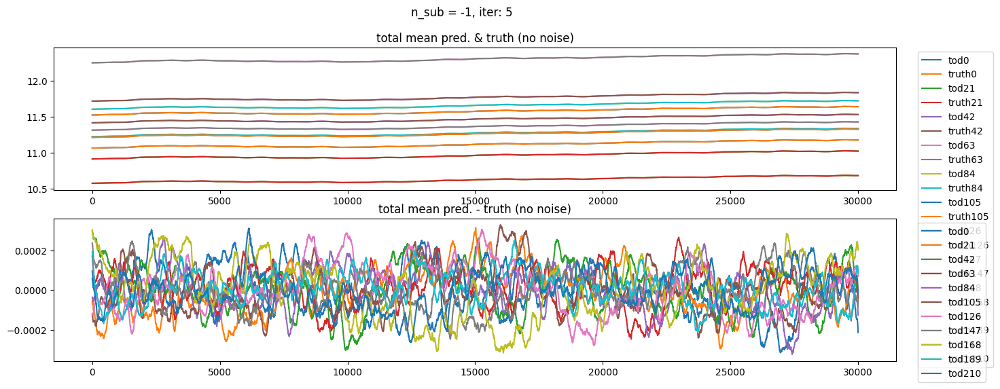

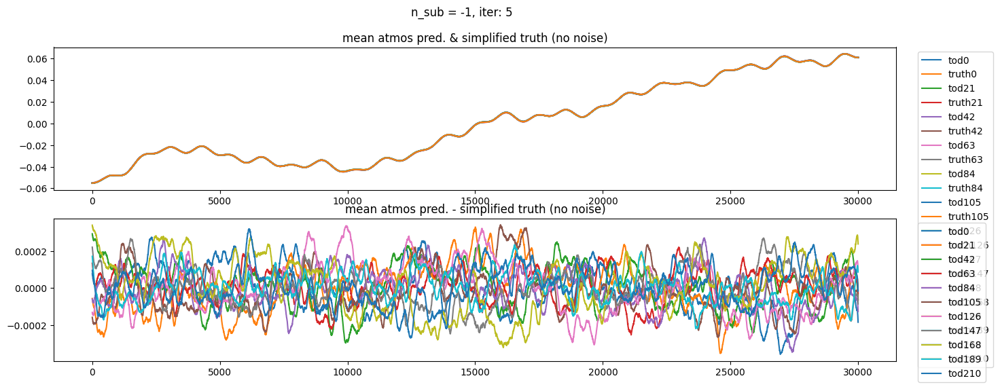

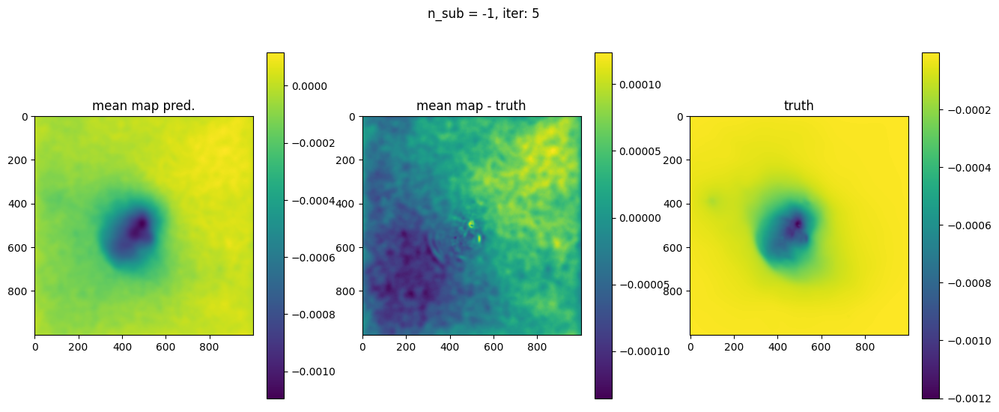

OPTIMIZE_KL: Starting 0006
SL: Iteration 0 ⛰:+3.4969e+08 Δ⛰:inf ➽:9.7001e+01
SL: Iteration 1 ⛰:+1.7726e+08 Δ⛰:1.7243e+08 ➽:9.7001e+01
SL: Iteration 2 ⛰:+9.2328e+07 Δ⛰:8.4927e+07 ➽:9.7001e+01
SL: Iteration 3 ⛰:+1.5762e+07 Δ⛰:7.6567e+07 ➽:9.7001e+01
SL: Iteration 4 ⛰:+8.8582e+06 Δ⛰:6.9034e+06 ➽:9.7001e+01
SL: Iteration 5 ⛰:+3.3729e+06 Δ⛰:5.4853e+06 ➽:9.7001e+01
SL: Iteration 6 ⛰:+5.7020e+05 Δ⛰:2.8026e+06 ➽:9.7001e+01
SL: Iteration 7 ⛰:+4.3510e+05 Δ⛰:1.3511e+05 ➽:9.7001e+01
SL: Iteration 8 ⛰:-1.2187e+05 Δ⛰:5.5697e+05 ➽:9.7001e+01
SL: Iteration 9 ⛰:-8.9990e+05 Δ⛰:7.7803e+05 ➽:9.7001e+01
SL: Iteration 10 ⛰:-1.0165e+06 Δ⛰:1.1659e+05 ➽:9.7001e+01
SL: Iteration 11 ⛰:-2.1091e+06 Δ⛰:1.0926e+06 ➽:9.7001e+01
SL: Iteration 12 ⛰:-2.3855e+06 Δ⛰:2.7646e+05 ➽:9.7001e+01
SL: Iteration 13 ⛰:-2.3877e+06 Δ⛰:2.1939e+03 ➽:9.7001e+01
SL: Iteration 14 ⛰:-2.6402e+06 Δ⛰:2.5249e+05 ➽:9.7001e+01
SL: Iteration 15 ⛰:-2.9443e+06 Δ⛰:3.0412e+05 ➽:9.7001e+01
SL: Iteration 16 ⛰:-3.0491e+06 Δ⛰:1.0478e+05 ➽:9.7001e+01
SL: 

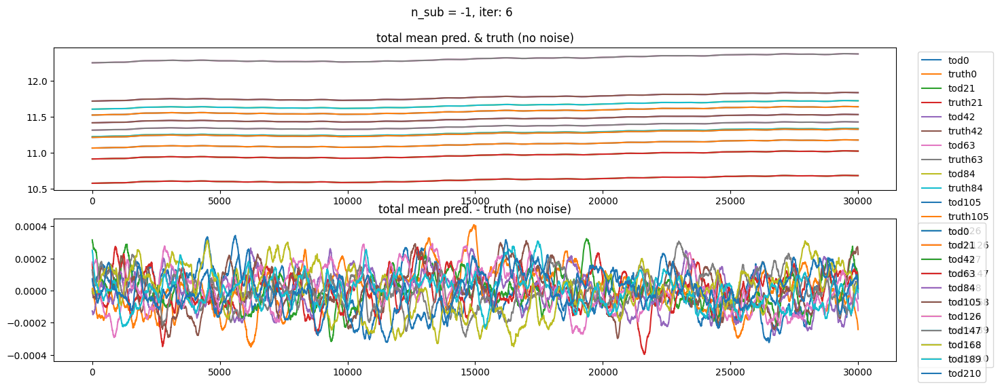

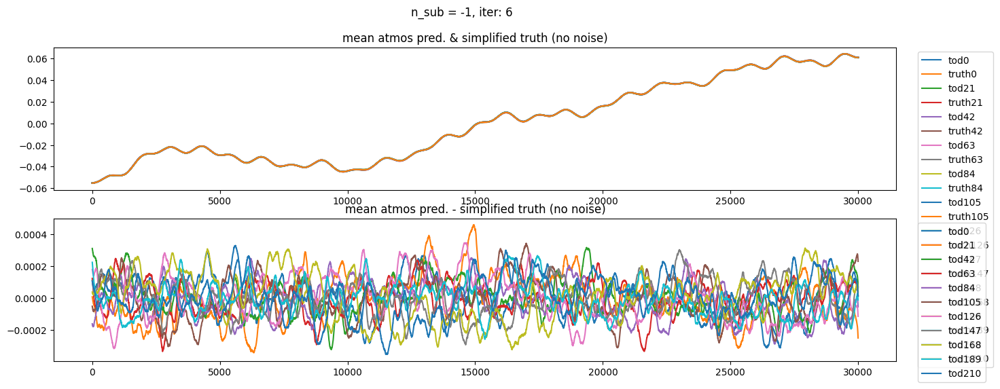

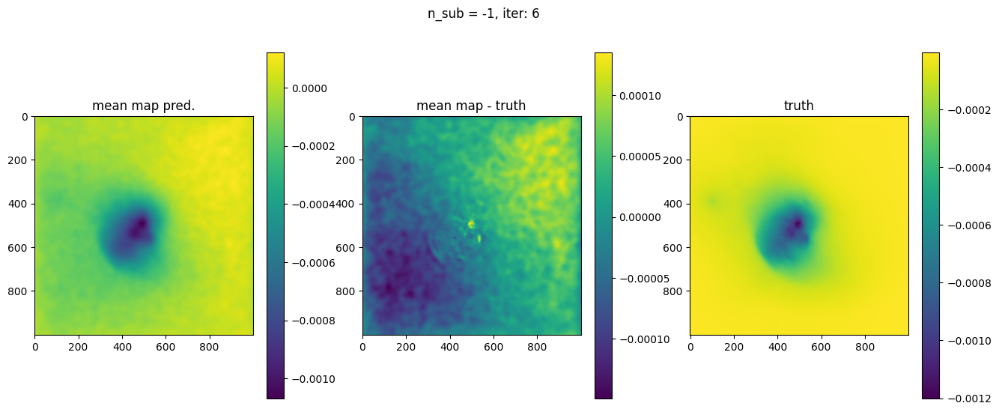

OPTIMIZE_KL: Starting 0007
SL: Iteration 0 ⛰:+1.1174e+08 Δ⛰:inf ➽:9.7001e+01
SL: Iteration 1 ⛰:+1.0896e+08 Δ⛰:2.7813e+06 ➽:9.7001e+01
SL: Iteration 2 ⛰:+1.0602e+08 Δ⛰:2.9388e+06 ➽:9.7001e+01
SL: Iteration 3 ⛰:+1.7332e+07 Δ⛰:8.8688e+07 ➽:9.7001e+01
SL: Iteration 4 ⛰:+9.7395e+06 Δ⛰:7.5926e+06 ➽:9.7001e+01
SL: Iteration 5 ⛰:+4.0003e+06 Δ⛰:5.7392e+06 ➽:9.7001e+01
SL: Iteration 6 ⛰:+8.9218e+05 Δ⛰:3.1081e+06 ➽:9.7001e+01
SL: Iteration 7 ⛰:+8.7913e+05 Δ⛰:1.3048e+04 ➽:9.7001e+01
SL: Iteration 8 ⛰:+2.3431e+05 Δ⛰:6.4483e+05 ➽:9.7001e+01
SL: Iteration 9 ⛰:-6.8227e+05 Δ⛰:9.1657e+05 ➽:9.7001e+01
SL: Iteration 10 ⛰:-7.6605e+05 Δ⛰:8.3778e+04 ➽:9.7001e+01
SL: Iteration 11 ⛰:-1.8696e+06 Δ⛰:1.1036e+06 ➽:9.7001e+01
SL: Iteration 12 ⛰:-2.2075e+06 Δ⛰:3.3783e+05 ➽:9.7001e+01
SL: Iteration 13 ⛰:-2.2092e+06 Δ⛰:1.6763e+03 ➽:9.7001e+01
SL: Iteration 14 ⛰:-2.4524e+06 Δ⛰:2.4325e+05 ➽:9.7001e+01
SL: Iteration 15 ⛰:-2.7921e+06 Δ⛰:3.3970e+05 ➽:9.7001e+01
SL: Iteration 16 ⛰:-2.9219e+06 Δ⛰:1.2979e+05 ➽:9.7001e+01
SL: 

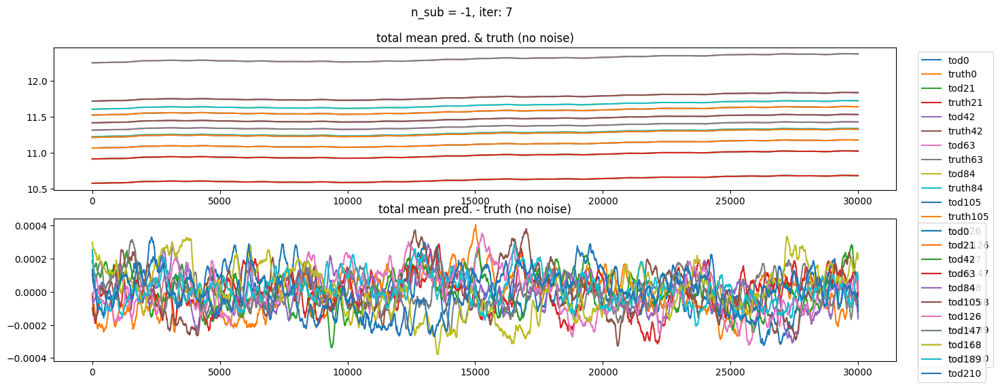

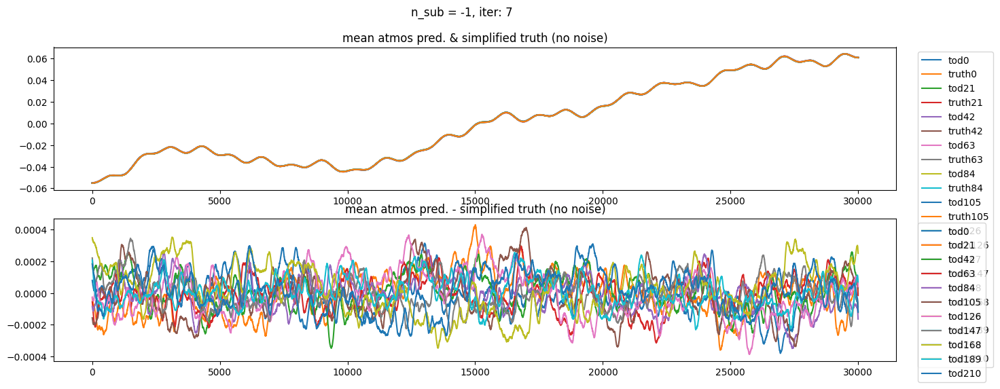

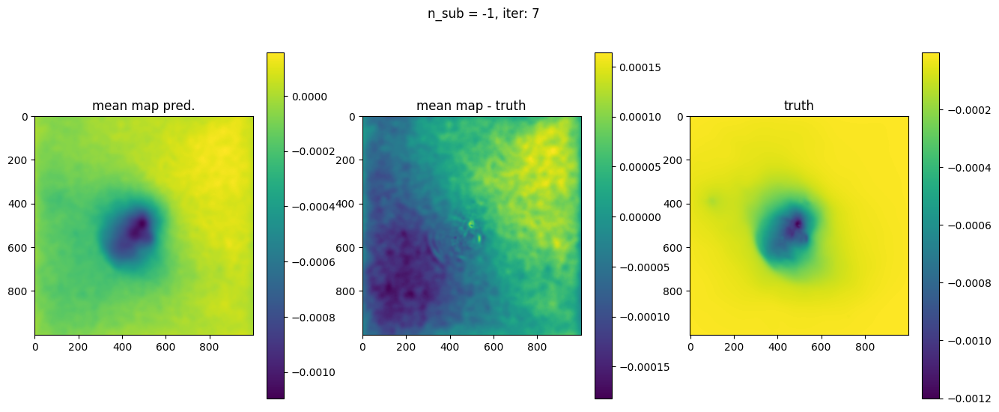

OPTIMIZE_KL: Starting 0008
SL: Iteration 0 ⛰:+3.5323e+08 Δ⛰:inf ➽:9.7001e+01
SL: Iteration 1 ⛰:+1.0929e+08 Δ⛰:2.4395e+08 ➽:9.7001e+01
SL: Iteration 2 ⛰:+8.8122e+07 Δ⛰:2.1164e+07 ➽:9.7001e+01
SL: Iteration 3 ⛰:+1.8478e+07 Δ⛰:6.9645e+07 ➽:9.7001e+01
SL: Iteration 4 ⛰:+1.0849e+07 Δ⛰:7.6287e+06 ➽:9.7001e+01
SL: Iteration 5 ⛰:+5.0225e+06 Δ⛰:5.8267e+06 ➽:9.7001e+01
SL: Iteration 6 ⛰:+2.9564e+06 Δ⛰:2.0661e+06 ➽:9.7001e+01
SL: Iteration 7 ⛰:+1.6088e+06 Δ⛰:1.3475e+06 ➽:9.7001e+01
SL: Iteration 8 ⛰:+9.2410e+05 Δ⛰:6.8473e+05 ➽:9.7001e+01
SL: Iteration 9 ⛰:-1.9419e+05 Δ⛰:1.1183e+06 ➽:9.7001e+01
SL: Iteration 10 ⛰:-1.1398e+06 Δ⛰:9.4559e+05 ➽:9.7001e+01
SL: Iteration 11 ⛰:-1.4621e+06 Δ⛰:3.2228e+05 ➽:9.7001e+01
SL: Iteration 12 ⛰:-1.5682e+06 Δ⛰:1.0612e+05 ➽:9.7001e+01
SL: Iteration 13 ⛰:-1.7868e+06 Δ⛰:2.1864e+05 ➽:9.7001e+01
SL: Iteration 14 ⛰:-2.1594e+06 Δ⛰:3.7260e+05 ➽:9.7001e+01
SL: Iteration 15 ⛰:-2.4893e+06 Δ⛰:3.2990e+05 ➽:9.7001e+01
SL: Iteration 16 ⛰:-2.6228e+06 Δ⛰:1.3343e+05 ➽:9.7001e+01
SL: 

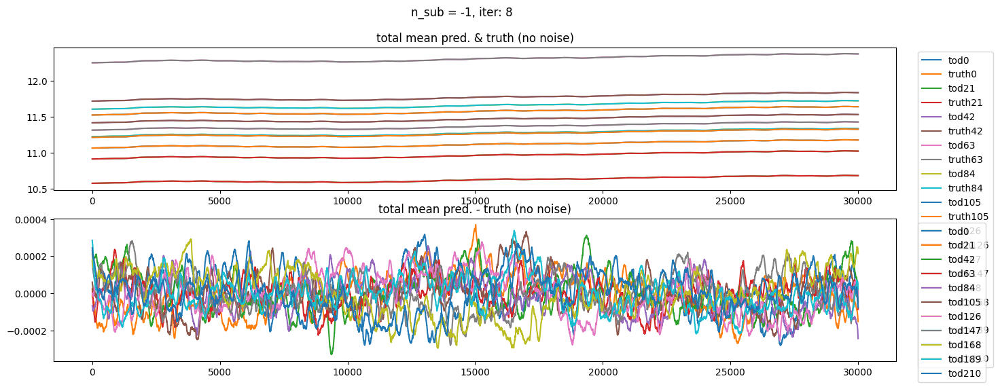

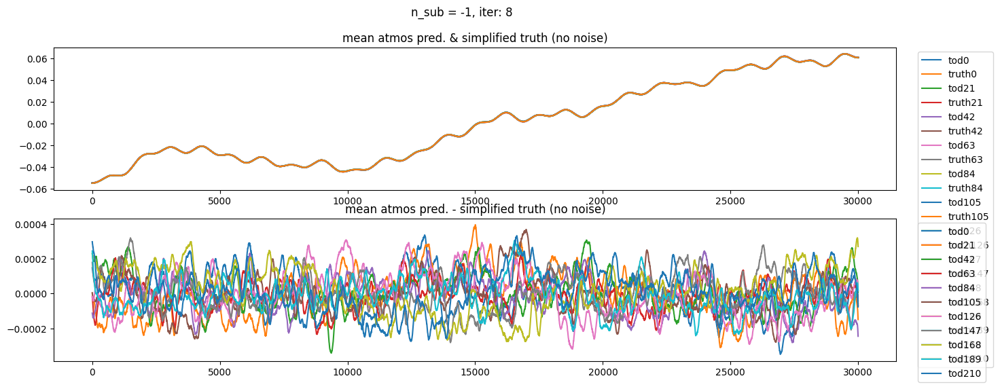

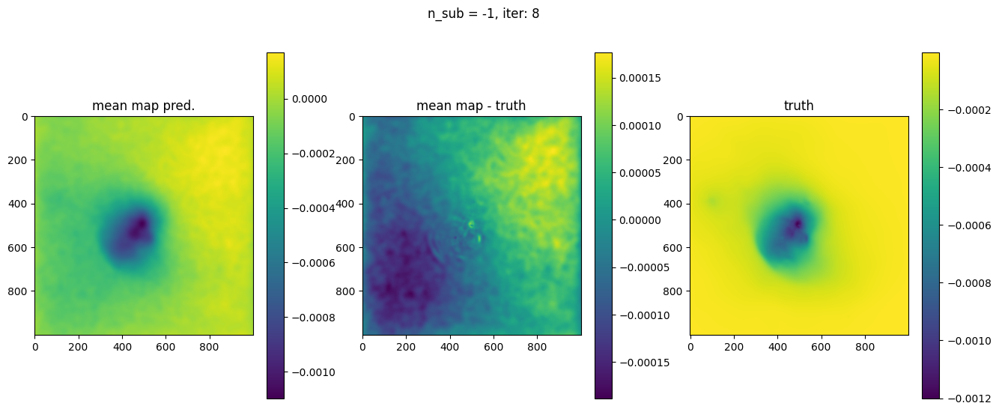

OPTIMIZE_KL: Starting 0009
SL: Iteration 0 ⛰:+1.4171e+08 Δ⛰:inf ➽:9.7001e+01
SL: Iteration 1 ⛰:+1.1136e+08 Δ⛰:3.0345e+07 ➽:9.7001e+01
SL: Iteration 2 ⛰:+9.6442e+07 Δ⛰:1.4918e+07 ➽:9.7001e+01
SL: Iteration 3 ⛰:+1.8517e+07 Δ⛰:7.7925e+07 ➽:9.7001e+01
SL: Iteration 4 ⛰:+1.0809e+07 Δ⛰:7.7081e+06 ➽:9.7001e+01
SL: Iteration 5 ⛰:+4.1650e+06 Δ⛰:6.6439e+06 ➽:9.7001e+01
SL: Iteration 6 ⛰:+1.5810e+06 Δ⛰:2.5840e+06 ➽:9.7001e+01
SL: Iteration 7 ⛰:+1.4781e+06 Δ⛰:1.0290e+05 ➽:9.7001e+01
SL: Iteration 8 ⛰:+8.1780e+05 Δ⛰:6.6025e+05 ➽:9.7001e+01
SL: Iteration 9 ⛰:-3.4890e+05 Δ⛰:1.1667e+06 ➽:9.7001e+01
SL: Iteration 10 ⛰:-3.7185e+05 Δ⛰:2.2943e+04 ➽:9.7001e+01
SL: Iteration 11 ⛰:-1.5308e+06 Δ⛰:1.1589e+06 ➽:9.7001e+01
SL: Iteration 12 ⛰:-1.8211e+06 Δ⛰:2.9030e+05 ➽:9.7001e+01
SL: Iteration 13 ⛰:-1.8369e+06 Δ⛰:1.5874e+04 ➽:9.7001e+01
SL: Iteration 14 ⛰:-2.2187e+06 Δ⛰:3.8178e+05 ➽:9.7001e+01
SL: Iteration 15 ⛰:-2.5411e+06 Δ⛰:3.2240e+05 ➽:9.7001e+01
SL: Iteration 16 ⛰:-2.6741e+06 Δ⛰:1.3299e+05 ➽:9.7001e+01
SL: 

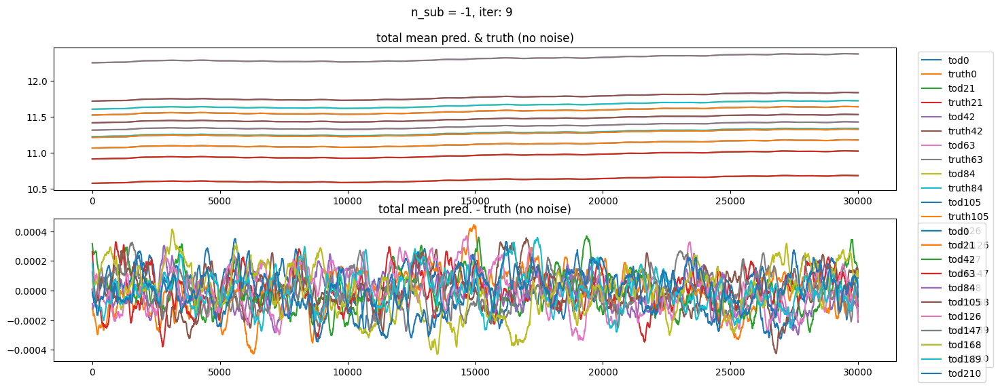

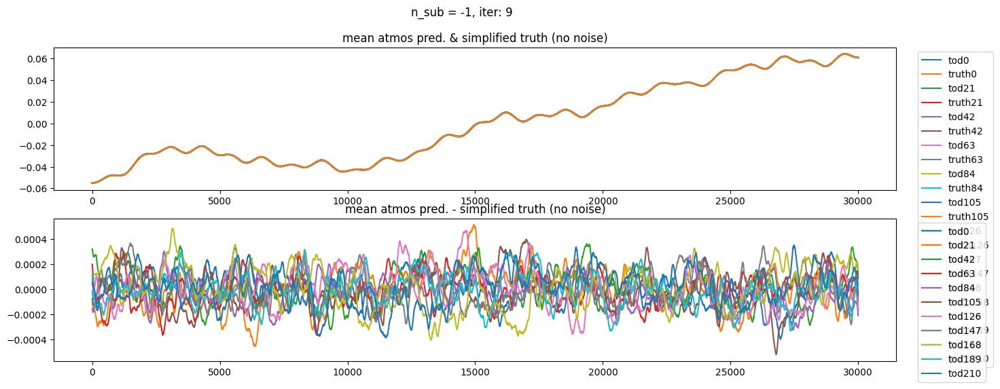

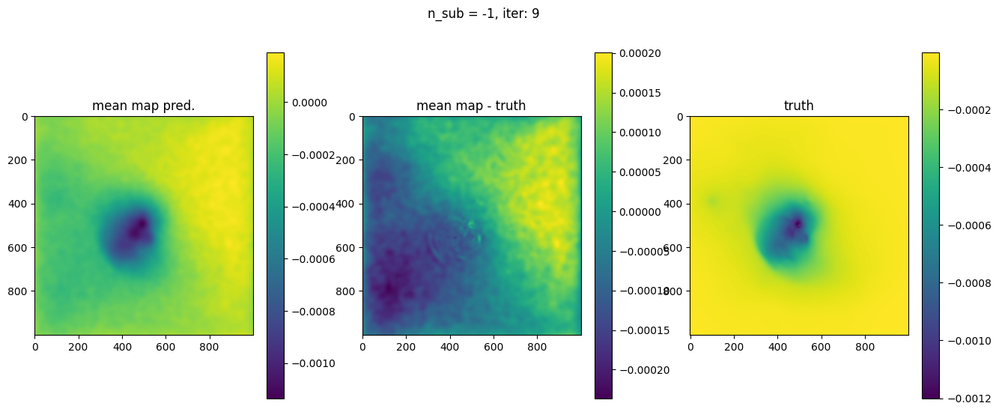

OPTIMIZE_KL: Starting 0010
SL: Iteration 0 ⛰:+3.2033e+08 Δ⛰:inf ➽:9.7001e+01
SL: Iteration 1 ⛰:+9.4514e+07 Δ⛰:2.2582e+08 ➽:9.7001e+01
SL: Iteration 2 ⛰:+9.1901e+07 Δ⛰:2.6127e+06 ➽:9.7001e+01
SL: Iteration 3 ⛰:+1.8341e+07 Δ⛰:7.3560e+07 ➽:9.7001e+01
SL: Iteration 4 ⛰:+1.1063e+07 Δ⛰:7.2782e+06 ➽:9.7001e+01
SL: Iteration 5 ⛰:+4.6007e+06 Δ⛰:6.4619e+06 ➽:9.7001e+01
SL: Iteration 6 ⛰:+3.5790e+06 Δ⛰:1.0217e+06 ➽:9.7001e+01
SL: Iteration 7 ⛰:+1.9920e+06 Δ⛰:1.5869e+06 ➽:9.7001e+01
SL: Iteration 8 ⛰:+1.2444e+06 Δ⛰:7.4758e+05 ➽:9.7001e+01
SL: Iteration 9 ⛰:-1.2602e+05 Δ⛰:1.3705e+06 ➽:9.7001e+01
SL: Iteration 10 ⛰:-2.3514e+05 Δ⛰:1.0912e+05 ➽:9.7001e+01
SL: Iteration 11 ⛰:-1.1988e+06 Δ⛰:9.6363e+05 ➽:9.7001e+01
SL: Iteration 12 ⛰:-1.2431e+06 Δ⛰:4.4323e+04 ➽:9.7001e+01
SL: Iteration 13 ⛰:-1.5037e+06 Δ⛰:2.6063e+05 ➽:9.7001e+01
SL: Iteration 14 ⛰:-1.9154e+06 Δ⛰:4.1163e+05 ➽:9.7001e+01
SL: Iteration 15 ⛰:-2.2349e+06 Δ⛰:3.1950e+05 ➽:9.7001e+01
SL: Iteration 16 ⛰:-2.4033e+06 Δ⛰:1.6841e+05 ➽:9.7001e+01
SL: 

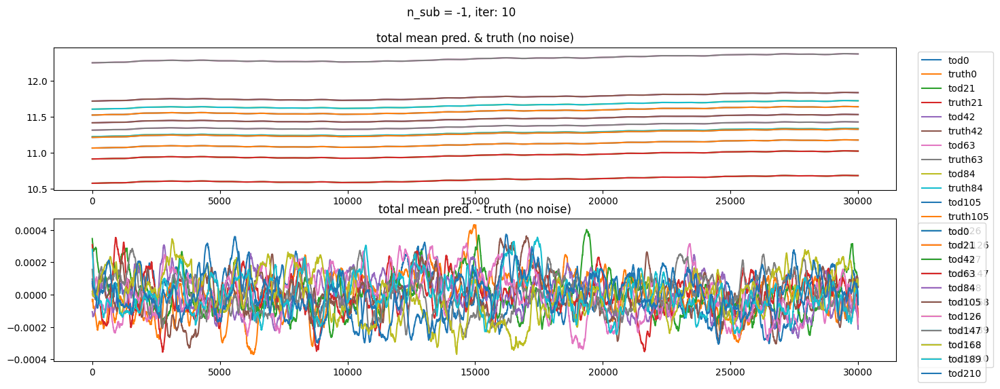

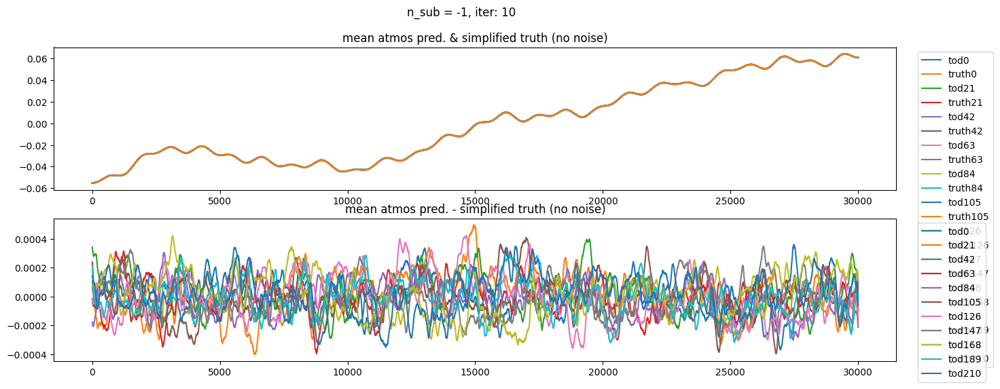

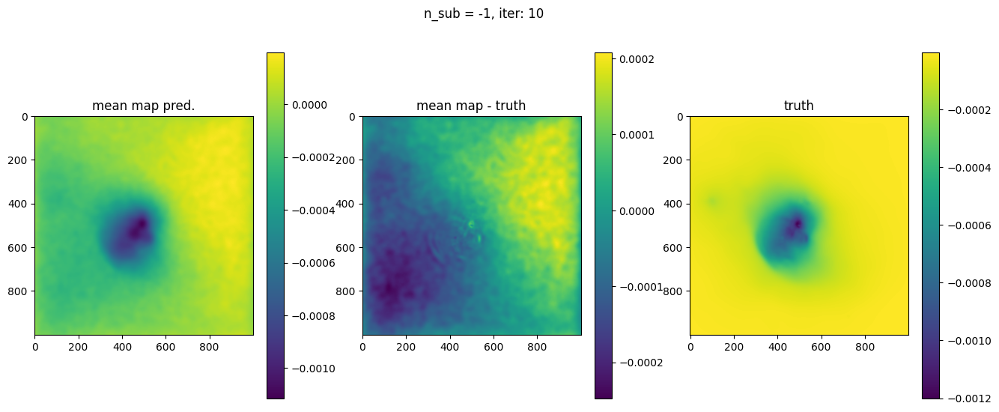

In [32]:
samples, state = fit.perform_fit(n_it=10, printevery=1)

In [33]:
fit.printfitresults(samples)

Fit Results (res, init, std) for n_sub = -1

TODs:
	fluctuations: 0.0014850552265999728, 0.0015, 0.0001
	loglogvarslope: -2.497675104934865, -2.45, 0.1
	zeromode std (LogNormal): 5.942544021995974e-07, 1e-05, 9.9e-06
map:
	fluctuations: 3.278905735713631e-05, 5.6e-05, 1e-06
	loglogvarslope: -2.0554846971754097, -2.5, 0.1
	zeromode std (LogNormal): 4.3763648591619037e-10, 1e-08, 1e-07


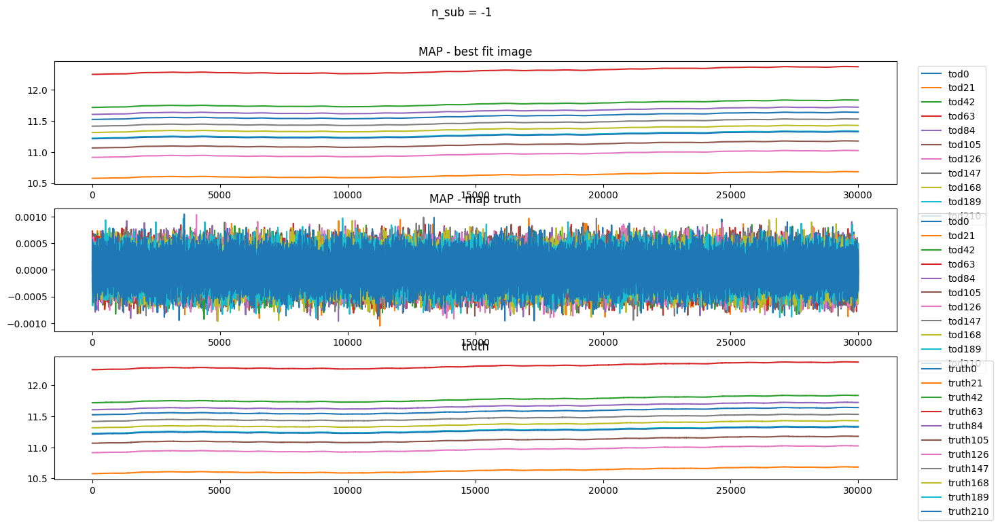

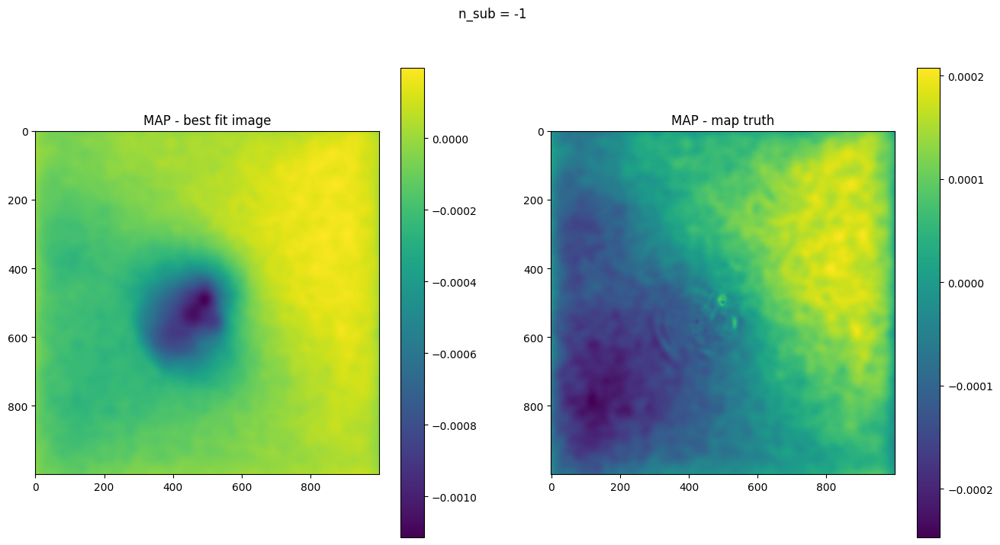

In [34]:
fit.plotfitresults(samples)

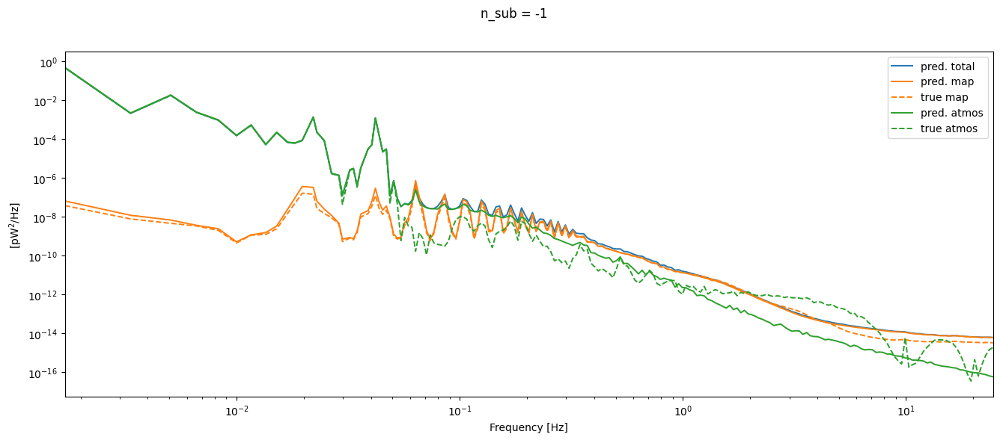

In [35]:
fit.plotpowerspectrum(samples)

In [36]:
# fit.make_atmosphere_det_gif(samples, figname='test.gif', tmax=2500)

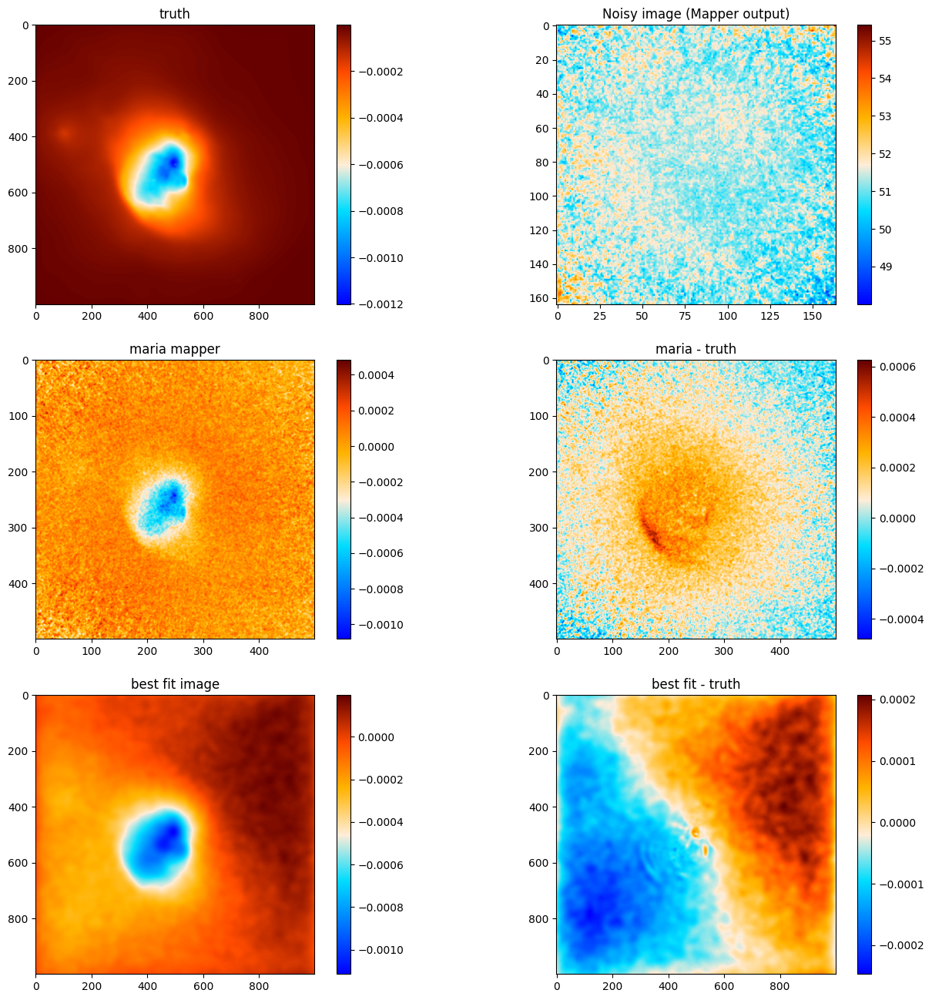

In [37]:
fit.plotrecos(samples)